# PIV with two pass of WiDIM refinement
- using code SPIVET-UCLA, available at https://github.com/xiyuanbao/SPIVET-UCLA

In [1363]:
%matplotlib inline
from matplotlib import rcParams
import matplotlib.pyplot as plt
rcParams['font.sans-serif']=['Arial']
rcParams["mathtext.fontset"] ='custom'
rcParams['mathtext.it']='stix:italic'#sans or stix
rcParams['mathtext.rm']='sans'
rcParams['mathtext.cal']='stix:italic'#use this for greek letters
rcParams['figure.dpi'] = 300 
rcParams['axes.linewidth']=0.4
rcParams['xtick.major.size']=1.5
rcParams['xtick.major.width']=0.4
rcParams['ytick.major.size']=1.5
rcParams['ytick.major.width']=0.4
rcParams['xtick.major.pad']=1.5
rcParams['ytick.major.pad']=1.5
rcParams['figure.facecolor']="white"

plt.rcParams['svg.fonttype'] = 'none'

In [1039]:
from spivet.pivlib import *
from spivet import pivlib

In [1041]:
from scipy.interpolate import RectBivariateSpline

In [1042]:
rcParams['figure.dpi'] = 300

In [1043]:
import cv2
def shadow_filter(ofDisp):
    
    
    
    Vx = ofDisp[2,0,:,:]
    Vy = ofDisp[1,0,:,:]
    ofDisp[2,0,:,:] = shadow_filter_internal(Vx)
    ofDisp[1,0,:,:] = shadow_filter_internal(Vy)
    return ofDisp
#################################################################
def shadow_filter_internal(Vx):
    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(7,7))
    passes=0
    opt=(None,20,7,21)
    opt2=(None,10,7,21)
    mask_threshold=0.3
    core_correction = 0.2
    back_amp_correction = 1.1
    
    
    #median + non-local means
    Vx_f = median_NL_filter(Vx,passes,opt)
    
    mask = Vx-Vx_f
    mask[np.abs(mask)>mask_threshold]=1
    mask[np.abs(mask)<=mask_threshold]=0
    #morphological opening to remove lines and waves = plume shadows
    #but preserve plume cores
    mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)
    
    Vx_f[mask>0]=Vx[mask>0]+(Vx[mask>0]-Vx_f[mask>0])*core_correction
    Vx_f = median_NL_filter(Vx_f,0,opt2)
    Vx_f[mask<=0]*=back_amp_correction
    
    return Vx_f
#################################################################
def median_NL_filter(img,passes,opt):
    crc=img
    for i in range(passes):
        crc=cv2.medianBlur(np.float32(crc),3)
        crc=cv2.medianBlur(np.float32(crc),5)
    mind,maxd=np.min(crc),np.max(crc)
    crc8=np.uint8((crc-mind)/(maxd-mind)*255)


    medianflow_new = cv2.fastNlMeansDenoising(crc8,*opt)#cv2.fastNlMeansDenoising(crc8,5,5,3,7)
    medianflow_new = (medianflow_new/255.0)*(maxd-mind)+mind
    return medianflow_new

In [1044]:
import numpy as np

In [1045]:
base = "../sample-data/piv/images/tif/particle_image_frame_000"
suffix = ".tif"
files = [base+"1"+suffix,base+"2"+suffix]


f1_ = imread(files[0])[-1]
f2_ = imread(files[1])[-1]

imdim = f1_.shape

pad_pix = 32
f1 = np.zeros([imdim[0]+pad_pix*2,imdim[1]+pad_pix*2])
f1[pad_pix:-pad_pix,pad_pix:-pad_pix] = f1_
f2 = np.zeros([imdim[0]+pad_pix*2,imdim[1]+pad_pix*2])
f2[pad_pix:-pad_pix,pad_pix:-pad_pix] = f2_

#overlapping window used, add 16 pixels to have 64x64 vectors
pivdict = {
    'gp_rbndx':np.array([[pad_pix,imdim[0]+pad_pix*1.5],[pad_pix,imdim[1]+pad_pix*1.5]]),
    'gp_bsize':(32,32),
    'gp_bolap':(16,16),
    'gp_bsdiv':1,
    
    
    'ir_eps':0.003,
    'ir_maxits':100,
    'ir_mineig':0.05,
    'ir_imthd':'C',
    'ir_iedge':0,
    'ir_tps_csrp':0.1,
    'ir_tps_ithp':90,
    'ir_tps_wsize':[5,5],
    'ir_tps_sdmyf':0.1,
    'ir_tps_alpha':0.8,
    'ir_tps_beta':1.5,
    'ir_tps_csize':15,
    'ir_tps_nits':30,
    'ir_tps_scit':5,
    'ir_tps_annl':0.98,
    
    'of_maxdisp':(15,5),
    'of_rmaxdisp':(3,3),
    'of_hrsc':False,
    'of_nccth':0.7,
    'of_highp':False,
    'of_bsdcmx':0.,
}

STARTING: imread
 | Path: /home/xbao/LAB_test/shadow_piv_sim/photon/sample-data/piv/images/tif/particle_image_frame_0001.tif
 | Mode: L
 | Size: (1024, 1024)
 | EXITING: imread
STARTING: imread
 | Path: /home/xbao/LAB_test/shadow_piv_sim/photon/sample-data/piv/images/tif/particle_image_frame_0002.tif
 | Mode: L
 | Size: (1024, 1024)
 | EXITING: imread


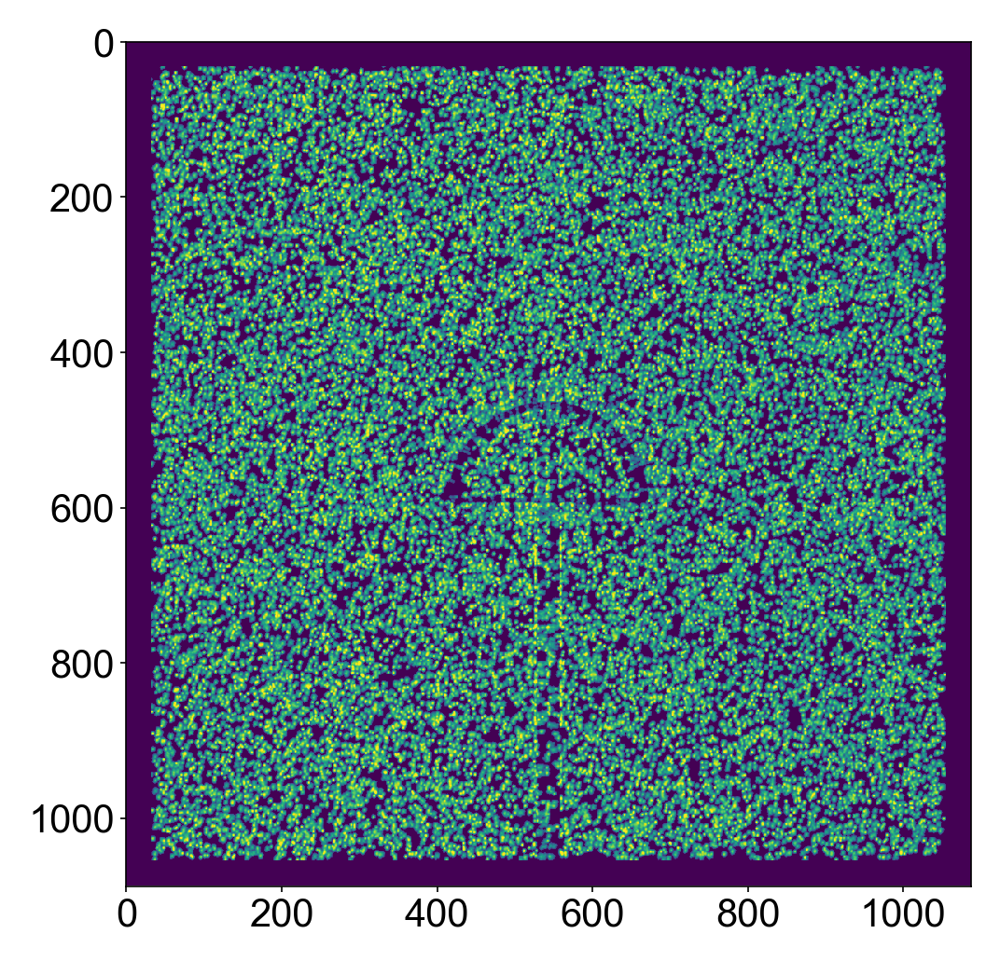

In [1046]:
plt.imshow(f1)

In [1047]:
rslt = ofcomp(f1,f2,pivdict)

STARTING: ofcomp
 | WARNING: Region not spanned by an integer number of blocks in y.
 | WARNING: Region not spanned by an integer number of blocks in x.
rsize,lbso,hbso,lnblks,hnblks= [1040. 1040.] [16 16] [32 32] [64 64] [64 64]
rbndx,bsize,bolap,bsdiv,bsdcmx= [[  32. 1072.]
 [  32. 1072.]] (32, 32) (16, 16) 1 0.0
 | nyblks 64
 | nxblks 64
 | Flow computation ...
 |  10% complete
 |  20% complete
 |  30% complete
 |  40% complete
 |  50% complete
 |  60% complete
 |  70% complete
 |  80% complete
 |  90% complete
 |  100% complete
 | NCC CMAX MEAN: 0.963331, STDDEV 0.041547
 | EXITING: ofcomp


In [1048]:
import cv2
def median_gaussian(ofDisp,blurry=True):
    ofDisp_ = ofDisp.copy()
    for i in [1,2]:
        blur=cv2.medianBlur(np.float32(ofDisp[i,0,:,:]),3)
        blur=cv2.medianBlur(blur,5)
        if blurry:
            blur = cv2.GaussianBlur(blur,(3,3),0)
        ofDisp_[i,0] = blur
    return ofDisp_

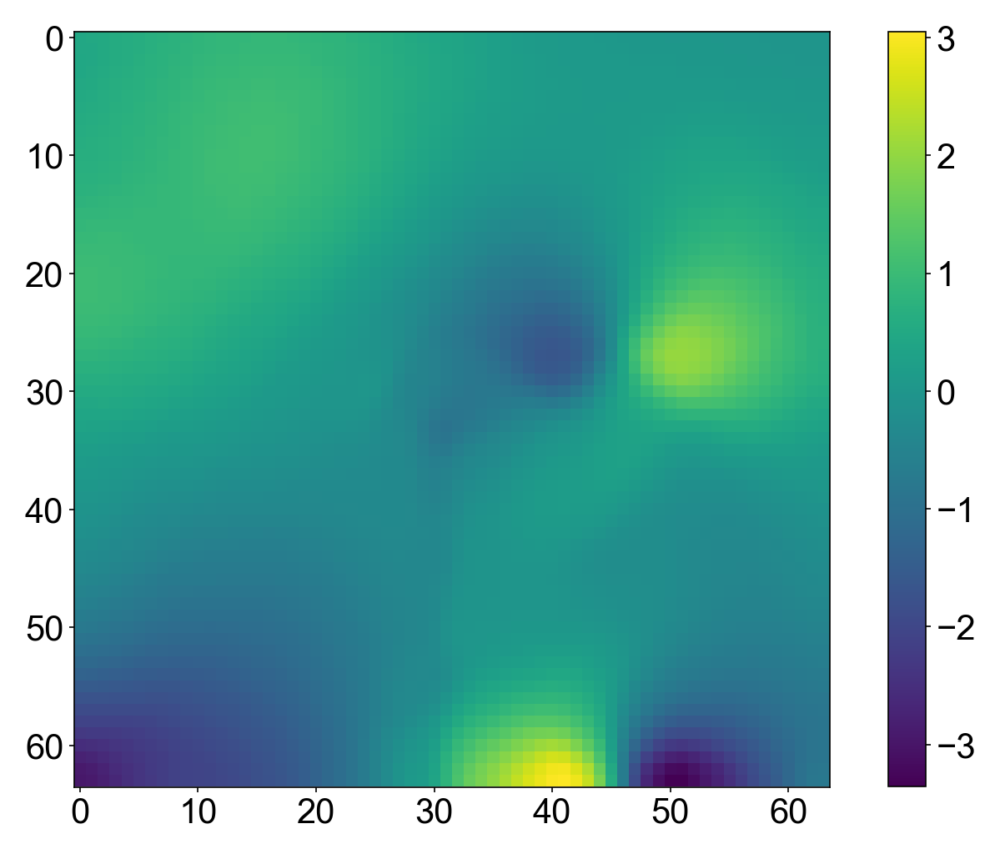

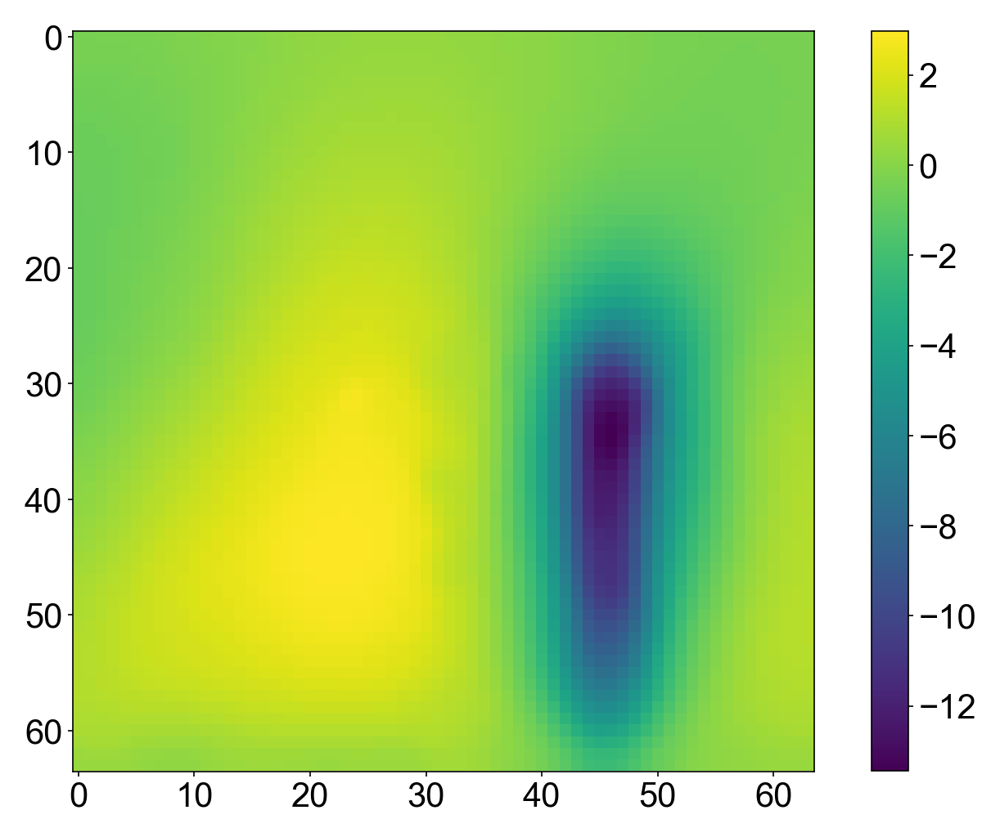

In [1049]:
ofDisp,ofINAC,ofCMAX = rslt

ofDisp = median_gaussian(ofDisp)
plt.imshow(ofDisp[2,0,:,:])
plt.colorbar()
plt.figure()
plt.imshow(ofDisp[1,0,:,:])
plt.colorbar()

## refinement pass 1

In [1052]:
def __regionprms__(pivdict,crbndx,pxorgn):
    """
    Computes region bounding indices and block center coords.
    """
    crsize   = crbndx[:,1] -crbndx[:,0]
    tnrcells = crsize.prod()

    # Get pivdict parameters.
    rbndx = array( pivdict['gp_rbndx'], dtype=int )
    bsize = array( pivdict['gp_bsize'], dtype=int )
    bolap = array( pivdict['gp_bolap'], dtype=int )
    bsdiv = pivdict['gp_bsdiv']

    maxdisp  = array( pivdict['of_maxdisp'] )
    rmaxdisp = array( pivdict['of_rmaxdisp'] )

    # Compute image region rbndx corresponding to crbndx.
    rrbndx = rbndx.copy()
    ebsize = (bsize -bolap)/bsdiv#bsdiv will not be used together with bsize>1 in ofcomp
    '''
    rrbndx[:,0] = rbndx[:,0] +crbndx[:,0]*ebsize -pxorgn
    rrbndx[:,1] = rbndx[:,0] +crbndx[:,1]*ebsize -pxorgn
    '''
    #Xiyuan:For overlapped cases, if keep crsize & tnrcells, we need to
    #compensate for the initial position 
    rrbndx[:,0] = rbndx[:,0] +crbndx[:,0]*ebsize -pxorgn 
    rrbndx[:,1] = rbndx[:,0] +crbndx[:,1]*ebsize -pxorgn +bolap

    # Compute extended rrbndx.  The extended region contains a border of
    # of_maxdisp +of_rmaxdisp pixels.  
    mxdsp   = maxdisp +rmaxdisp
    xrrbndx = rrbndx.copy()

    xrrbndx[:,0] = xrrbndx[:,0] -mxdsp
    xrrbndx[:,1] = xrrbndx[:,1] +mxdsp

    xrrsize = xrrbndx[:,1] -xrrbndx[:,0]

    # Setup image indices and block center coordinates (in pixels) for the
    # extended region.  Coordinates are relative to the extended region.
    xrrfn = indices(xrrsize,dtype=float)
    xrrfn = xrrfn.reshape([2,xrrfn[0].size]).transpose()
    xrrfn = xrrfn +xrrbndx[:,0]

    wxrrfn = zeros(xrrfn.shape,dtype=float)

    bco    = bsize/(2.*bsdiv)
    bccrds = indices(crsize,dtype=float)
    for i in xrange(2):
        bccrds[i,...] = ebsize[i]*bccrds[i,...] +rrbndx[i,0] +bco[i]

    bccrds  = bccrds.reshape([2,tnrcells]).transpose()

    # Build the dictionary.
    rprms = {'crsize':crsize,
             'tnrcells':tnrcells,
             'xrrbndx':xrrbndx,
             'xrrsize':xrrsize,
             'rrbndx':rrbndx,
             'xrrfn':xrrfn,
             'wxrrfn':wxrrfn,
             'bccrds':bccrds}

    return rprms

In [1053]:
crbndx  = array([[0,ofDisp.shape[-2]],[0,ofDisp.shape[-1]]])

crsize   = crbndx[:,1] -crbndx[:,0]
tnrcells = crsize.prod()


# Get a reference to the original rbndx.  We'll need to restore this
# later.
orbndx = pivdict['gp_rbndx']

# Grab the pixel origin for the extended region in relation to
# the full image.
rprms   = __regionprms__(pivdict,crbndx,[0,0])
xrrbndx = rprms['xrrbndx']
pxorgn  = xrrbndx[:,0]

ocrbndx = crbndx

print "-v-v-v-v-v- REFINE2DOF -v-v-v-v-v-"
print "EXT REGION: [%i:%i,%i:%i] PIX" % tuple(xrrbndx.reshape(4))



# Get region parameters for cam 0.
pivdict['gp_rbndx'] = orbndx

crbndx = ocrbndx
rprms  = __regionprms__(pivdict,crbndx,pxorgn)

crsize   = rprms['crsize']
tnrcells = rprms['tnrcells']
xrrbndx  = rprms['xrrbndx']
xrrsize  = rprms['xrrsize']
rrbndx   = rprms['rrbndx']
xrrfn    = rprms['xrrfn']
wxrrfn   = rprms['wxrrfn']
bccrds   = rprms['bccrds']
            
            

-v-v-v-v-v- REFINE2DOF -v-v-v-v-v-
EXT REGION: [14:1090,24:1080] PIX


In [1054]:
pf0_cam0 = f1.copy()
rfactor=1.2
var = ofDisp.copy()
dbccrds = bccrds +var[1:3,0,...].reshape([2,tnrcells]).transpose()



# initialize the principle warp matrix
tps     = pivlib.pivutil.tpswarp(dbccrds,bccrds,lmda=0.,forwardonly=True)

# Get warped coordinates (ie, coordinates to warp Frame 0).  
# Do the fast approximate TPS for large region
# TPS on a corasegrid (cstep) inside fine border grid (flen)
# Then interpolate to per pixel grid using bivariate spline
# cstep=20-> max error<0.045 (1 time) default value
# cstep=16-> max error<0.025 (1.4 time)
# cstep=10-> max error~0.01(2 time)

if var.shape[2]>50 and var.shape[3]>50:
    flen=10;cstep=20
elif var.shape[2]>25 and var.shape[3]>25:
    flen=5;cstep=5
elif var.shape[2]>10 and var.shape[3]>10:
    flen=2;cstep=2
else:
    flen=0;cstep=0

if flen>0 and cstep > 0:
    ydim,xdim = np.array(xrrfn[-1]-xrrfn[0]+1,dtype=int)
    ysub = np.concatenate((np.arange(0,flen),np.arange(flen,ydim-flen,cstep),
                         np.arange(ydim-flen,ydim)),axis=None)+xrrfn[0][0]
    xsub = np.concatenate((np.arange(0,flen),np.arange(flen,xdim-flen,cstep),
                         np.arange(xdim-flen,xdim)),axis=None)+xrrfn[0][1]

    x2d,y2d = np.meshgrid(xsub,ysub)
    xrrfn_sub = np.array([y2d.flatten(),x2d.flatten()]).transpose()
    wxrrfn_sub = tps.xfrm(xrrfn_sub)
    p_sub = xrrfn_sub -wxrrfn_sub

    ytps_sub = p_sub[:,0].reshape(y2d.shape)
    xtps_sub = p_sub[:,1].reshape(x2d.shape)
    interp_spliney = RectBivariateSpline(ysub, xsub, ytps_sub)
    interp_splinex = RectBivariateSpline(ysub, xsub, xtps_sub)
    yo = np.arange(ydim)+xrrfn[0][0]
    xo = np.arange(xdim)+xrrfn[0][1]
    ytps = interp_spliney(yo, xo)
    xtps = interp_splinex(yo, xo)

    p = np.array([ytps,xtps]).reshape(2,-1).transpose()
else:#original TPS
    wxrrfn = tps.xfrm(xrrfn)
    p = xrrfn -wxrrfn



wimg = pivlib.pivutil.pxshift(f1,xrrfn.astype(int),p)

wimg = wimg.reshape(xrrsize)


pf0_cam0[xrrbndx[0,0]:xrrbndx[0,1],
         xrrbndx[1,0]:xrrbndx[1,1]] = wimg




In [1055]:
# Compute flow.
[crc,inac,cmax] = pivlib.ofcomp(pf0_cam0,
                                        f2,
                                        pivdict)
#Xiyuan
# if not gpu: 
#     [crc,inac,cmax] = pivlib.ofcomp(pf0[cam],
#                                         fimgs[cam][1],
#                                         pivdict)
# else:
#     try:
#         [crc,inac,cmax] = pivlib.ofcomp_gpu(pf0[cam],
#                                         fimgs[cam][1],
#                                         pivdict)
#     except:
#         print "OPENPIV Failed. Use ofcomp."
#         [crc,inac,cmax] = pivlib.ofcomp(pf0[cam],
#                                         fimgs[cam][1],
#                                         pivdict)
        
# Filter the correction and apply.
# crc = self.__cfilter__(crc, cfltrprm)
# median3,median5,optional guassian

# import cv2
# blur=cv2.medianBlur(np.float32(ofDisp[2,0,:,:]),3)
# blur=cv2.medianBlur(blur,5)
# blur = cv2.GaussianBlur(blur,(5,5),0)

# cmag = crc[1:3,...].reshape([2,tnrcells])
# cmag = sqrt( (cmag*cmag).sum(0) )
# cmmx = cmag.max()
# print "IT%i MAX |CRC|: %f" % (it,cmmx)
crc = median_gaussian(crc)
rfactor=1.2
var = var +rfactor*crc

             

STARTING: ofcomp
 | WARNING: Region not spanned by an integer number of blocks in y.
 | WARNING: Region not spanned by an integer number of blocks in x.
rsize,lbso,hbso,lnblks,hnblks= [1040. 1040.] [16 16] [32 32] [64 64] [64 64]
rbndx,bsize,bolap,bsdiv,bsdcmx= [[  32. 1072.]
 [  32. 1072.]] (32, 32) (16, 16) 1 0.0
 | nyblks 64
 | nxblks 64
 | Flow computation ...
 |  10% complete
 |  20% complete
 |  30% complete
 |  40% complete
 |  50% complete
 |  60% complete
 |  70% complete
 |  80% complete
 |  90% complete
 |  100% complete
 | NCC CMAX MEAN: 0.981645, STDDEV 0.035712
 | EXITING: ofcomp


## refinement pass 2

In [1056]:
pf0_cam0 = f1.copy()
rfactor=1.2
# var = ofDisp.copy()
dbccrds = bccrds +var[1:3,0,...].reshape([2,tnrcells]).transpose()



# initialize the principle warp matrix
tps     = pivlib.pivutil.tpswarp(dbccrds,bccrds,lmda=0.,forwardonly=True)

# Get warped coordinates (ie, coordinates to warp Frame 0).  
# Do the fast approximate TPS for large region
# TPS on a corasegrid (cstep) inside fine border grid (flen)
# Then interpolate to per pixel grid using bivariate spline
# cstep=20-> max error<0.045 (1 time) default value
# cstep=16-> max error<0.025 (1.4 time)
# cstep=10-> max error~0.01(2 time)

if var.shape[2]>50 and var.shape[3]>50:
    flen=10;cstep=20
elif var.shape[2]>25 and var.shape[3]>25:
    flen=5;cstep=5
elif var.shape[2]>10 and var.shape[3]>10:
    flen=2;cstep=2
else:
    flen=0;cstep=0

if flen>0 and cstep > 0:
    ydim,xdim = np.array(xrrfn[-1]-xrrfn[0]+1,dtype=int)
    ysub = np.concatenate((np.arange(0,flen),np.arange(flen,ydim-flen,cstep),
                         np.arange(ydim-flen,ydim)),axis=None)+xrrfn[0][0]
    xsub = np.concatenate((np.arange(0,flen),np.arange(flen,xdim-flen,cstep),
                         np.arange(xdim-flen,xdim)),axis=None)+xrrfn[0][1]

    x2d,y2d = np.meshgrid(xsub,ysub)
    xrrfn_sub = np.array([y2d.flatten(),x2d.flatten()]).transpose()
    wxrrfn_sub = tps.xfrm(xrrfn_sub)
    p_sub = xrrfn_sub -wxrrfn_sub

    ytps_sub = p_sub[:,0].reshape(y2d.shape)
    xtps_sub = p_sub[:,1].reshape(x2d.shape)
    interp_spliney = RectBivariateSpline(ysub, xsub, ytps_sub)
    interp_splinex = RectBivariateSpline(ysub, xsub, xtps_sub)
    yo = np.arange(ydim)+xrrfn[0][0]
    xo = np.arange(xdim)+xrrfn[0][1]
    ytps = interp_spliney(yo, xo)
    xtps = interp_splinex(yo, xo)

    p = np.array([ytps,xtps]).reshape(2,-1).transpose()
else:#original TPS
    wxrrfn = tps.xfrm(xrrfn)
    p = xrrfn -wxrrfn



wimg = pivlib.pivutil.pxshift(f1,xrrfn.astype(int),p)

wimg = wimg.reshape(xrrsize)


pf0_cam0[xrrbndx[0,0]:xrrbndx[0,1],
         xrrbndx[1,0]:xrrbndx[1,1]] = wimg




In [1057]:
# Compute flow.
[crc,inac,cmax] = pivlib.ofcomp(pf0_cam0,
                                        f2,
                                        pivdict)
#Xiyuan
# if not gpu: 
#     [crc,inac,cmax] = pivlib.ofcomp(pf0[cam],
#                                         fimgs[cam][1],
#                                         pivdict)
# else:
#     try:
#         [crc,inac,cmax] = pivlib.ofcomp_gpu(pf0[cam],
#                                         fimgs[cam][1],
#                                         pivdict)
#     except:
#         print "OPENPIV Failed. Use ofcomp."
#         [crc,inac,cmax] = pivlib.ofcomp(pf0[cam],
#                                         fimgs[cam][1],
#                                         pivdict)
        
# Filter the correction and apply.
# crc = self.__cfilter__(crc, cfltrprm)
# median3,median5,optional guassian

# import cv2
# blur=cv2.medianBlur(np.float32(ofDisp[2,0,:,:]),3)
# blur=cv2.medianBlur(blur,5)
# blur = cv2.GaussianBlur(blur,(5,5),0)

# cmag = crc[1:3,...].reshape([2,tnrcells])
# cmag = sqrt( (cmag*cmag).sum(0) )
# cmmx = cmag.max()
# print "IT%i MAX |CRC|: %f" % (it,cmmx)
# crc = median_gaussian(crc,blurry=False)
rfactor=1.2
# var = var +rfactor*crc

STARTING: ofcomp
 | WARNING: Region not spanned by an integer number of blocks in y.
 | WARNING: Region not spanned by an integer number of blocks in x.
rsize,lbso,hbso,lnblks,hnblks= [1040. 1040.] [16 16] [32 32] [64 64] [64 64]
rbndx,bsize,bolap,bsdiv,bsdcmx= [[  32. 1072.]
 [  32. 1072.]] (32, 32) (16, 16) 1 0.0
 | nyblks 64
 | nxblks 64
 | Flow computation ...
 |  10% complete
 |  20% complete
 |  30% complete
 |  40% complete
 |  50% complete
 |  60% complete
 |  70% complete
 |  80% complete
 |  90% complete
 |  100% complete
 | NCC CMAX MEAN: 0.986584, STDDEV 0.033635
 | EXITING: ofcomp


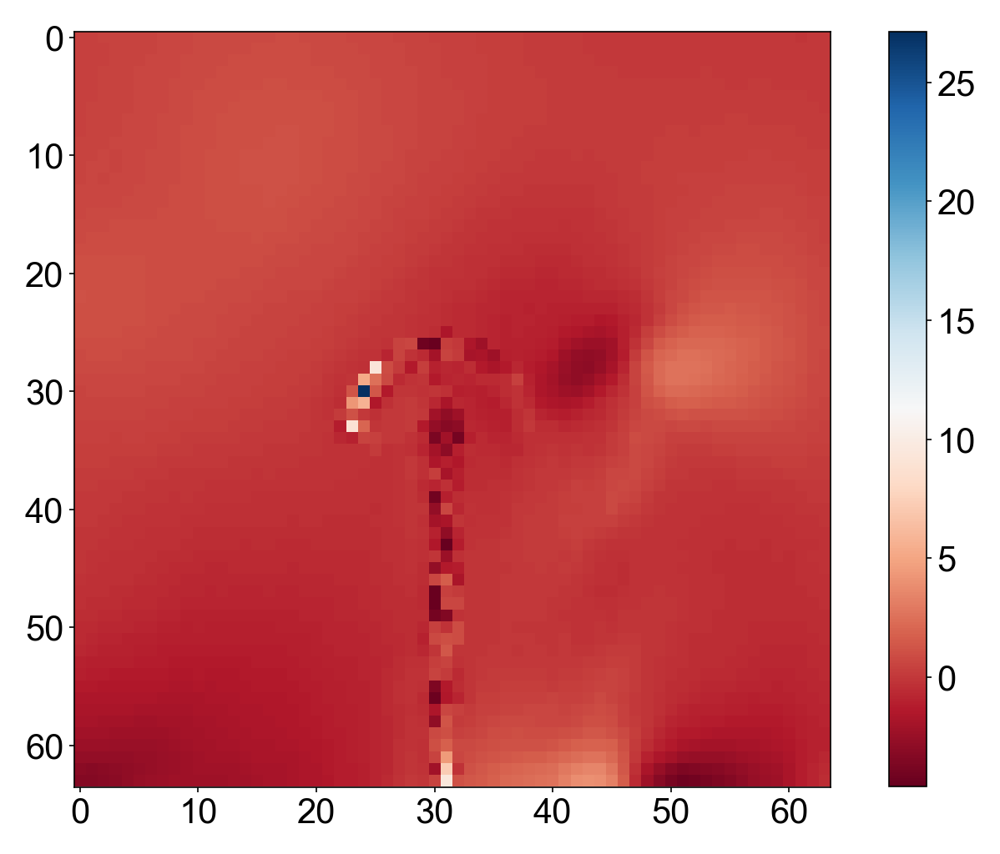

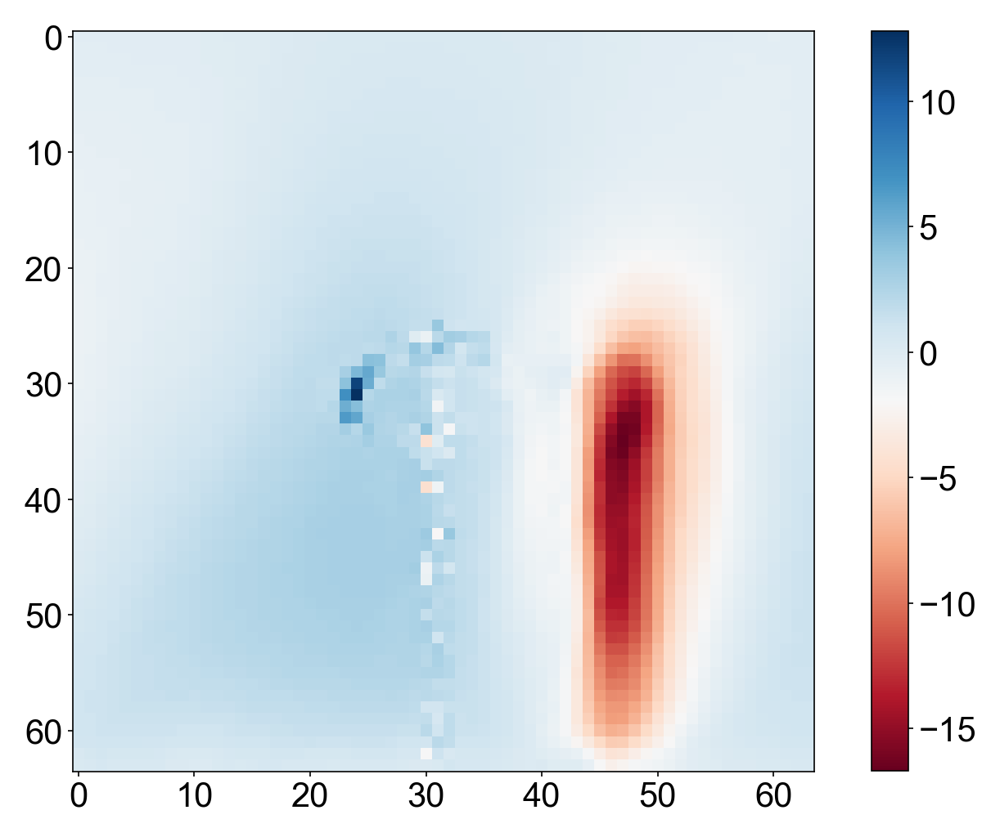

In [1058]:
var_ = var +rfactor*crc

plt.imshow(var_[2,0,:,:],cmap="RdBu")
plt.colorbar()
plt.figure()
plt.imshow(var_[1,0,:,:],cmap="RdBu")
plt.colorbar()

## median filter

In [1059]:
def median(ofDisp):
    ofDisp_ = ofDisp.copy()
    Vy,Vx = ofDisp_[1,0],ofDisp_[2,0]
    
    for i,V in enumerate([Vy,Vx]):
        crc=cv2.medianBlur(np.float32(V),3)
#         crc=cv2.medianBlur(np.float32(crc),5)
        ofDisp_[i+1]=crc
    return ofDisp_
var_ = median(var +rfactor*crc)#median 3 only

# PIV plume filter

In [1063]:
def fast_filter(img,passes,opt):
    crc=img
    for i in range(passes):
        crc=cv2.medianBlur(np.float32(crc),3)
        crc=cv2.medianBlur(np.float32(crc),5)
    mind,maxd=np.min(crc),np.max(crc)
    crc8=np.uint8((crc-mind)/(maxd-mind)*255)


    medianflow_new = cv2.fastNlMeansDenoising(crc8,*opt)#cv2.fastNlMeansDenoising(crc8,5,5,3,7)
    medianflow_new = (medianflow_new/255.0)*(maxd-mind)+mind
    return medianflow_new

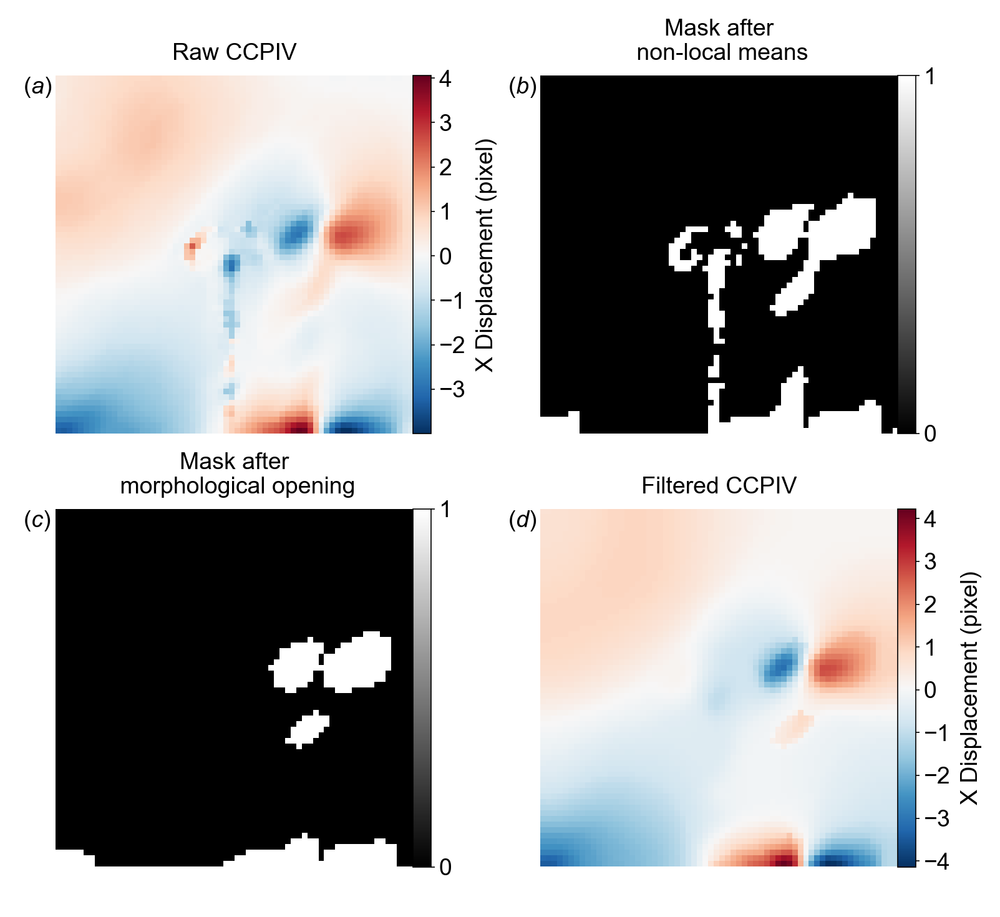

In [1332]:
import cv2
fs = 9
loffset = -0.036


passes = 5
Vx0 = var_[2,0].copy()
# Vx0 = fast_filter(Vx0, passes, opt)
# Setup for the plots
plt.figure(figsize=(6.68,5))

# 1st subplot: Raw CCPIV
plt.subplot(2,2,1)
plt.imshow(Vx0, cmap="RdBu_r")#,vmin=-4.5,vmax=3
cbar = plt.colorbar(pad=0)
plt.axis('off')
cbar.set_label("X Displacement (pixel)",fontsize=fs)
cbar.ax.tick_params(labelsize=fs) 
plt.title("Raw CCPIV",fontsize = fs)
plt.annotate('$(a)$', xy=(loffset*2.5, 1), xycoords='axes fraction', fontsize=fs, va='top')


# Apply fast filter and create the mask
Vx_0 = fast_filter(Vx0, passes, opt)
mask = Vx0 - Vx_0
Vx_0 = fast_filter(Vx0, 0, opt)
mask_threshold = 0.3
mask[np.abs(mask)>mask_threshold] = 1
mask[np.abs(mask)<=mask_threshold] = 0

# 2nd subplot: Mask after Non-local Means
plt.subplot(2,2,2)
plt.imshow(mask, cmap="gray")
cbar = plt.colorbar(pad=0, ticks=[0, 1])
cbar.ax.tick_params(labelsize=fs)

plt.axis('off')
# cbar.set_label("Mask Value")
plt.title("Mask after\n non-local means",fontsize = fs)
plt.annotate('$(b)$', xy=(loffset*2.5, 1), xycoords='axes fraction', fontsize=fs, va='top')

# Perform morphological opening
kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (5,3))
mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)
# kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (3,3))
# mask = cv2.dilate(mask, kernel,iterations = 1)
# kernel = cv2.getStructuringElement(cv2.MORPH_CROSS, (7,3))
# mask = cv2.erode(mask,kernel,iterations = 1)
# kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (4,3))
# mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)
# 3rd subplot: Mask after Morphological Opening
plt.subplot(2,2,3)
plt.imshow(mask, cmap="gray")
cbar = plt.colorbar(pad=0, ticks=[0, 1])
cbar.ax.tick_params(labelsize=fs) 
plt.axis('off')
# cbar.set_label("Mask Value")
plt.title("Mask after\n morphological opening",fontsize = fs)
plt.annotate('$(c)$', xy=(loffset*2.5, 1), xycoords='axes fraction', fontsize=fs, va='top')

# Apply final adjustments and filters
Vx_0[mask > 0] = Vx0[mask > 0] + (Vx0[mask > 0] - Vx_0[mask > 0]) * 0.2
Vx_0[mask <= 0] *= 1.1
Vx_0 = fast_filter(Vx_0, 0, (3, 3, 3, 9))


# 4th subplot: Filtered CCPIV
plt.subplot(2,2,4)
plt.imshow(Vx_0, cmap="RdBu_r")
cbar = plt.colorbar(pad=0)
plt.axis('off')
cbar.set_label("X Displacement (pixel)",fontsize=fs)
cbar.ax.tick_params(labelsize=fs) 
plt.title("Filtered CCPIV",fontsize = fs)
plt.annotate('$(d)$', xy=(loffset*2.5, 1), xycoords='axes fraction', fontsize=fs, va='top')

# Adjust spacing between subplots and show the figure

plt.tight_layout(w_pad = -8, h_pad = -0.5)
# plt.savefig("dx_synthetic.svg")

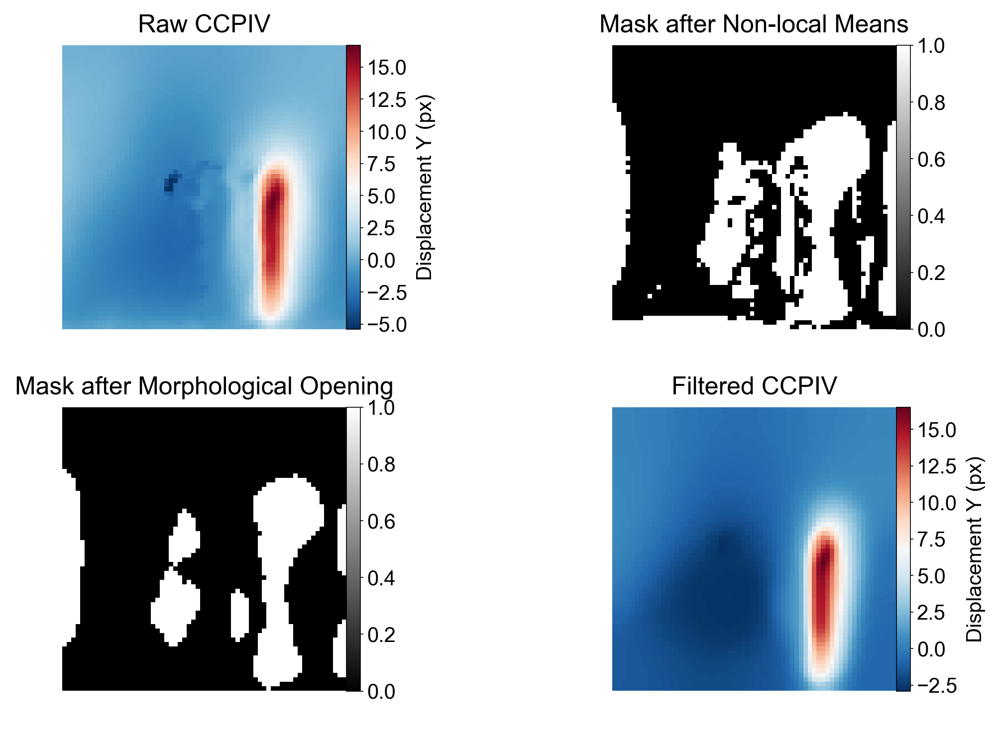

In [1327]:
import cv2
passes = 5
Vy0 = -var_[1,0].copy()
# Vy0 = fast_filter(Vy0, passes, opt)
# Setup for the plots
plt.figure(figsize=(8,5))

# 1st subplot: Raw CCPIV
plt.subplot(2,2,1)
plt.imshow(Vy0, cmap="RdBu_r")#,vmin=-24,vmax=2
cbar = plt.colorbar(pad=0)
plt.axis('off')
cbar.set_label("Displacement Y (px)")
plt.title("Raw CCPIV")

# Apply fast filter and create the mask
Vy_0 = fast_filter(Vy0, passes, opt)
mask = Vy0 - Vy_0
Vy_0 = fast_filter(Vy0, 0, opt)
mask_threshold = 0.3
mask[np.abs(mask)>mask_threshold] = 1
mask[np.abs(mask)<=mask_threshold] = 0

# 2nd subplot: Mask after Non-local Means
plt.subplot(2,2,2)
plt.imshow(mask, cmap="gray")
cbar = plt.colorbar(pad=0)
plt.axis('off')
# cbar.set_label("Mask Value")
plt.title("Mask after Non-local Means")

# Perform morphological opening
kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (4,7))
mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)
# kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (3,3))
# mask = cv2.dilate(mask, kernel,iterations = 1)
# kernel = cv2.getStructuringElement(cv2.MORPH_CROSS, (7,3))
# mask = cv2.erode(mask,kernel,iterations = 1)
# kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (4,3))
# mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)
# 3rd subplot: Mask after Morphological Opening
plt.subplot(2,2,3)
plt.imshow(mask, cmap="gray")
cbar = plt.colorbar(pad=0)
plt.axis('off')
# cbar.set_label("Mask Value")
plt.title("Mask after Morphological Opening")

# Apply final adjustments and filters
Vy_0[mask > 0] = Vy0[mask > 0] + (Vy0[mask > 0] - Vy_0[mask > 0]) * 0.2
Vy_0[mask <= 0] *= 1.1
Vy_0 = fast_filter(Vy_0, 0, (9,9,7,21))


# 4th subplot: Filtered CCPIV
plt.subplot(2,2,4)
plt.imshow(Vy_0, cmap="RdBu_r")
cbar = plt.colorbar(pad=0)
plt.axis('off')
cbar.set_label("Displacement Y (px)")
plt.title("Filtered CCPIV")

# Adjust spacing between subplots and show the figure

plt.tight_layout()
# plt.savefig("shadow_report.svg")

# PSD

In [1342]:
import scipy.stats as stats
# def Famp(u,v):
#     return np.sqrt(v*v+u*u)
def Famp(u,v):
    return np.sqrt(u+1j*v)
def PSD1d(input2d):
    ydim,xdim=input2d.shape
    fourier_image = np.fft.fftn(input2d)
    fourier_amplitudes = np.abs(fourier_image)**2

    kfreq1 = np.fft.fftfreq(xdim)*xdim/ydim #*1200->cycles/image, no *1200->esssentially cycles/pixel
    kfreq2 = np.fft.fftfreq(ydim)*1 #*1000
    kfreq2D = np.meshgrid(kfreq1, kfreq2)
    knrm = np.sqrt(kfreq2D[0]**2 + kfreq2D[1]**2)

    knrm = knrm.flatten()
    fourier_amplitudes = fourier_amplitudes.flatten()

    kbins = np.arange(0.5, 501., 1.)/ydim
    kvals = 0.5 * (kbins[1:] + kbins[:-1])
    Abins, _, _ = stats.binned_statistic(knrm, fourier_amplitudes,
                                         statistic = "mean",
                                         bins = kbins)
    Abins *= np.pi * (kbins[1:]**2 - kbins[:-1]**2)
    return kvals, Abins

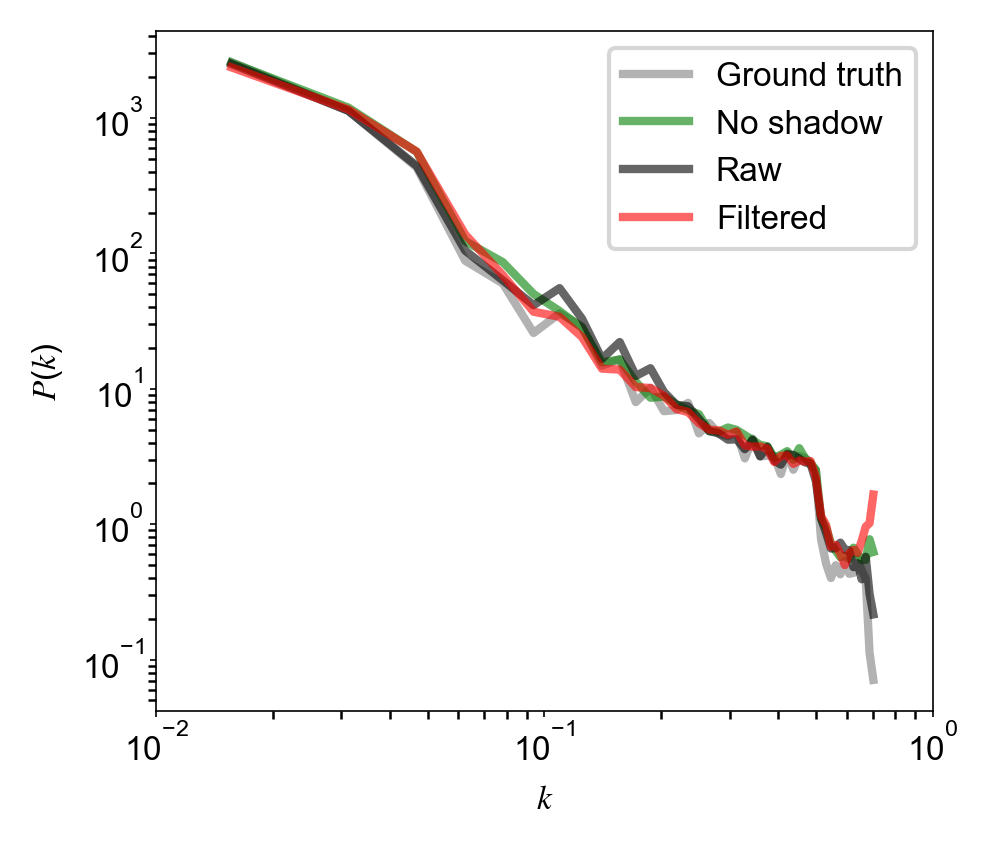

In [1364]:
fs = 8


kin,pin=PSD1d(Famp(synthetic_per_pixel["u"][::-1,][::16,::16],synthetic_per_pixel["v"][::-1,][::16,::16]))
kraw,praw=PSD1d(Famp(Vx0,Vy0))
kfil,pfil=PSD1d(Famp(Vx_0,Vy_0))
kpiv,ppiv = PSD1d(Famp(ccpiv_noshadow["u"],-ccpiv_noshadow["v"]))
plt.figure(figsize=(3.34,3))
plt.loglog(kin,pin,color="gray",label="Ground truth",linewidth=2,alpha=0.6)

plt.loglog(kpiv,ppiv,color="g",label="No shadow",linewidth=2,alpha=0.6)
plt.loglog(kraw,praw,color="k",label="Raw",linewidth=2,alpha=0.6)
plt.loglog(kfil,pfil,color="r",label="Filtered",linewidth=2,alpha=0.6)
plt.legend(fontsize=fs)
plt.xlabel("$k$",fontsize=fs)
plt.ylabel("$P(k)$",fontsize=fs)
plt.xticks([1e-2,1e-1,1],fontsize=fs)
plt.yticks(fontsize=fs)
plt.savefig("PSD_synthetic.svg")

# prepare for the metric plot

In [694]:
synthetic_per_pixel = np.load("synthetic_2d.npz")

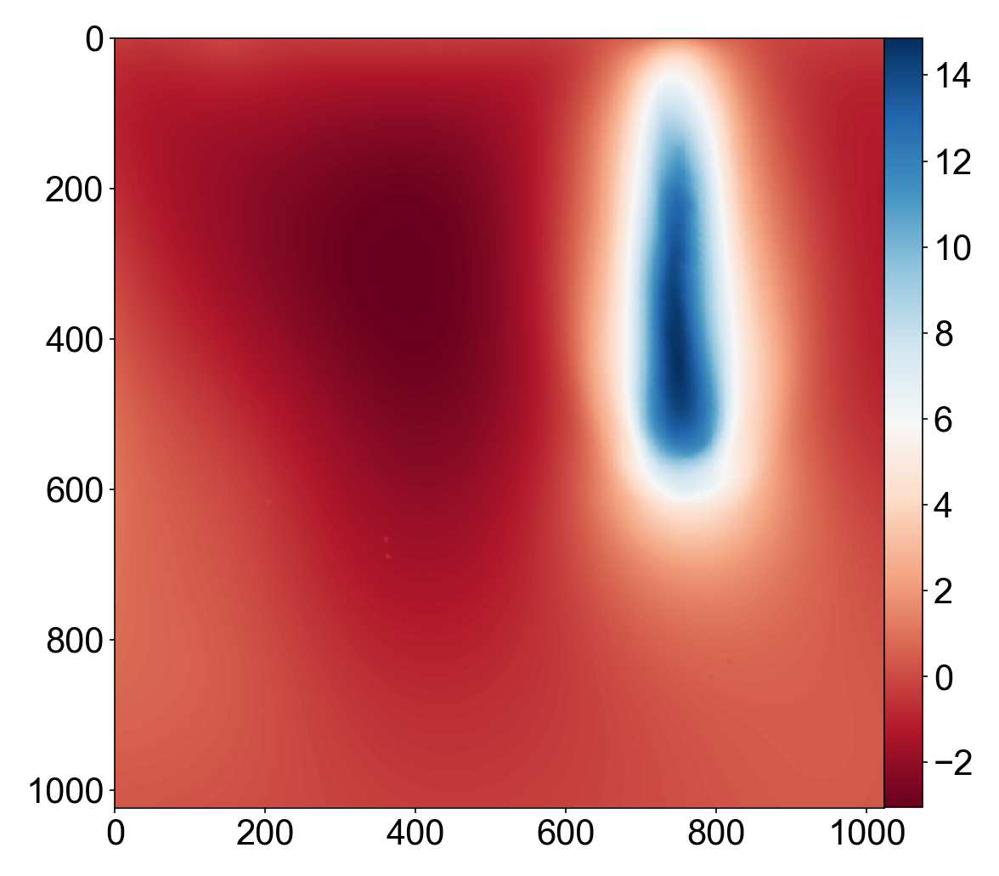

In [696]:
plt.imshow(synthetic_per_pixel["v"], cmap="RdBu")
cbar = plt.colorbar(pad=0)

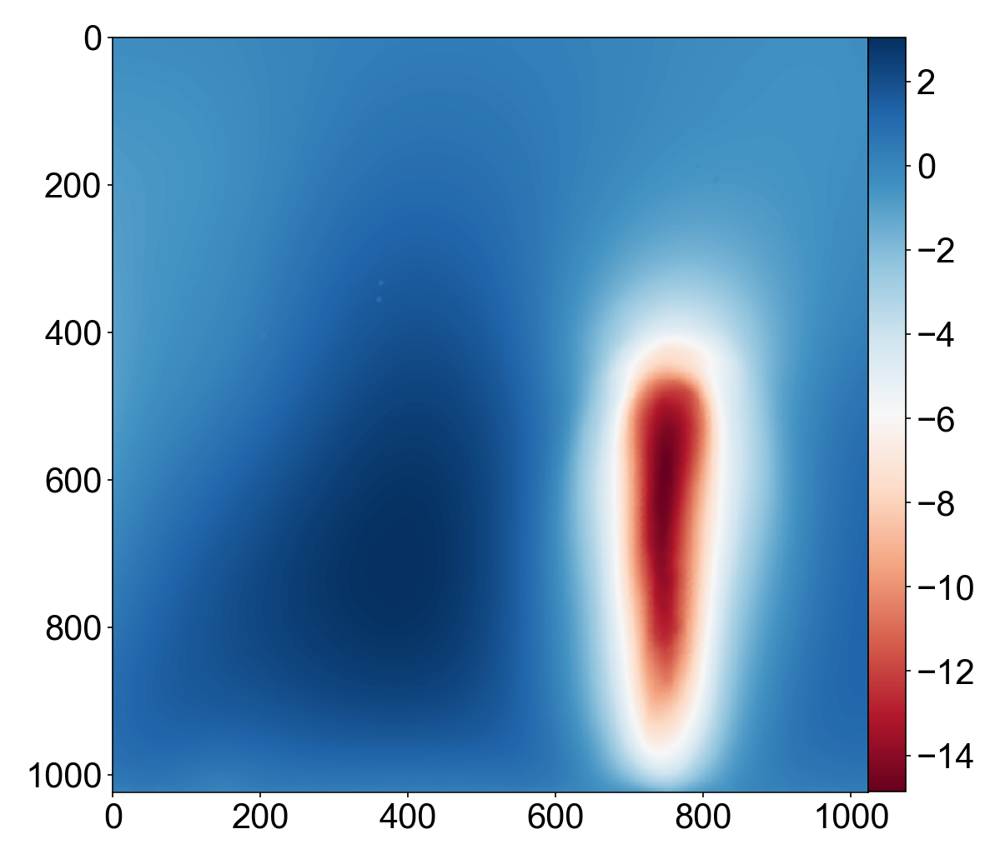

In [697]:
plt.imshow(-synthetic_per_pixel["v"][::-1,], cmap="RdBu")
cbar = plt.colorbar(pad=0)

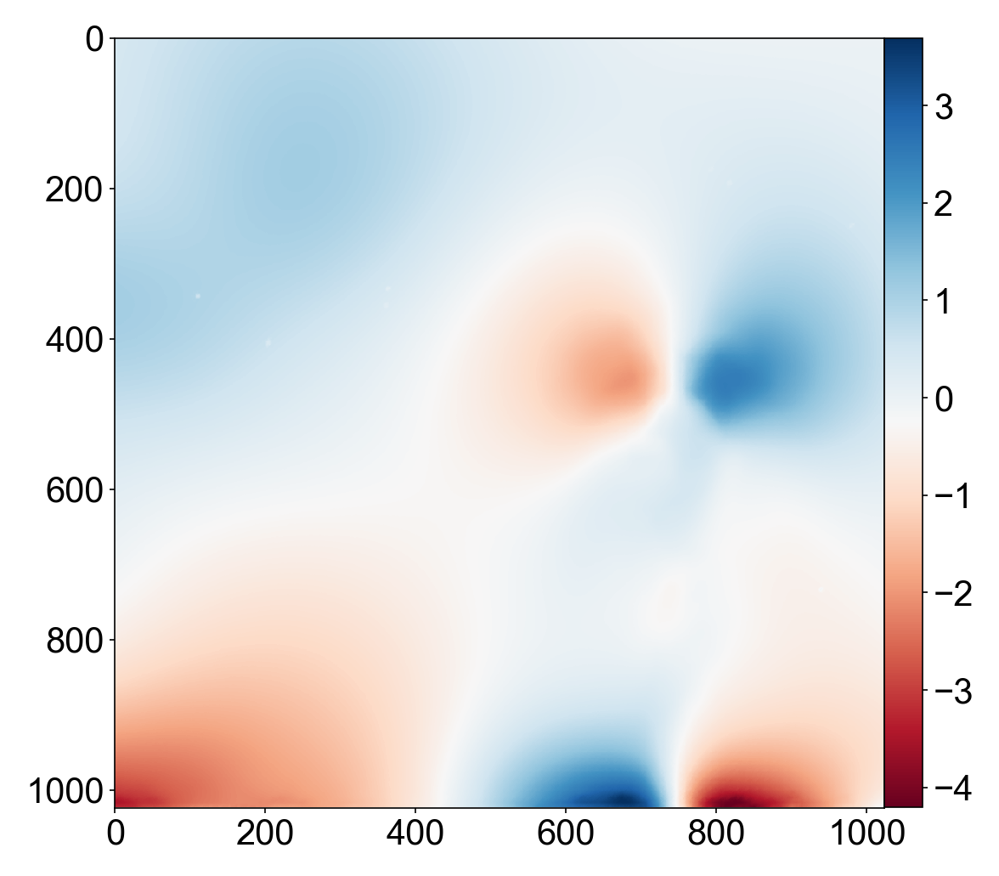

In [715]:
plt.imshow(synthetic_per_pixel["u"][::-1,], cmap="RdBu")
cbar = plt.colorbar(pad=0)

In [711]:
data_x = synthetic_per_pixel["u"][::-1,]
data_y = -synthetic_per_pixel["v"][::-1,]

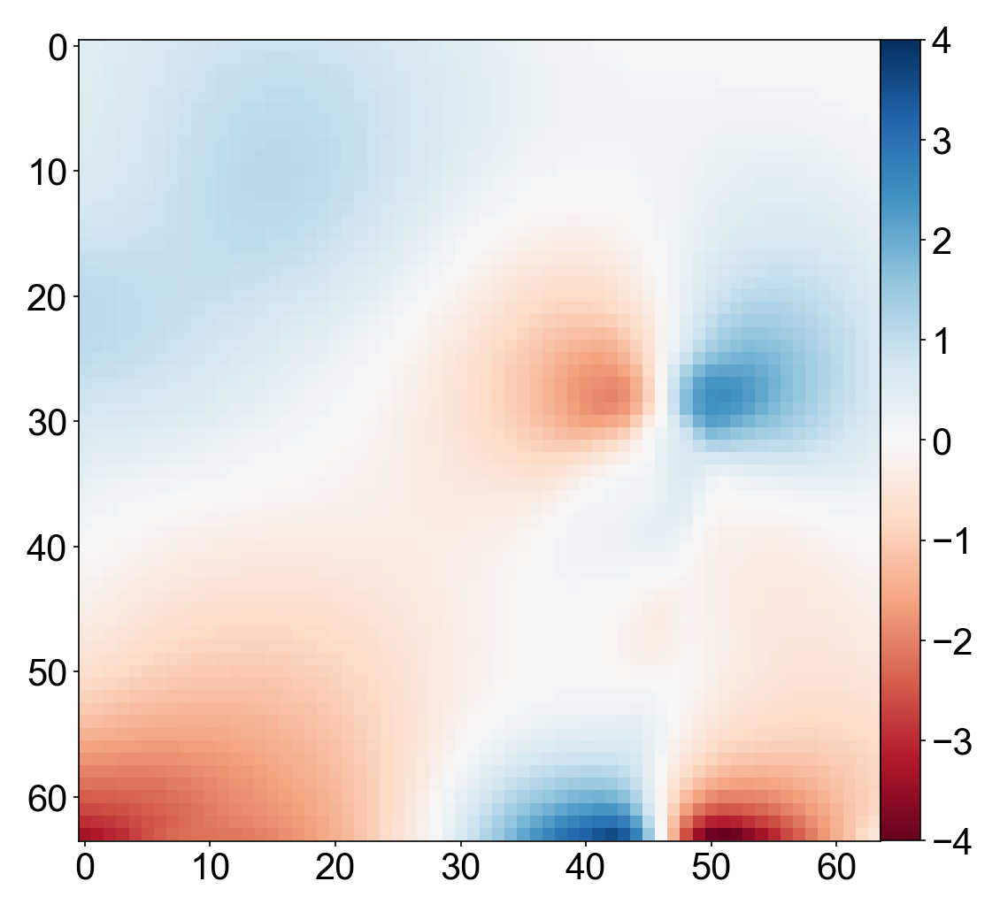

In [708]:
block_size = 16
reshaped_data = data_x.reshape(1024 // block_size, block_size, 1024 // block_size, block_size)
block_means = reshaped_data.mean(axis=(1, 3))
plt.figure()
plt.imshow(block_means, cmap="RdBu",vmin=-4,vmax=4)
cbar = plt.colorbar(pad=0)

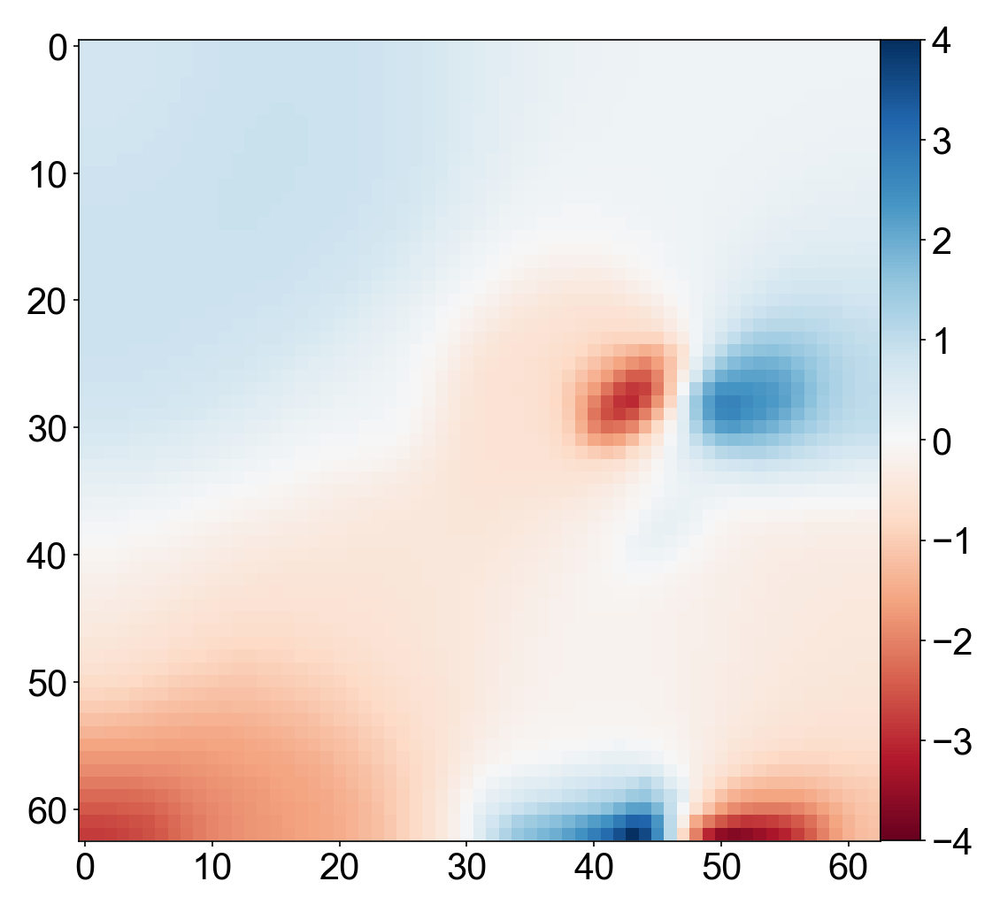

In [725]:
plt.imshow(Vx_0, cmap="RdBu",vmin=-4,vmax=4)
cbar = plt.colorbar(pad=0)

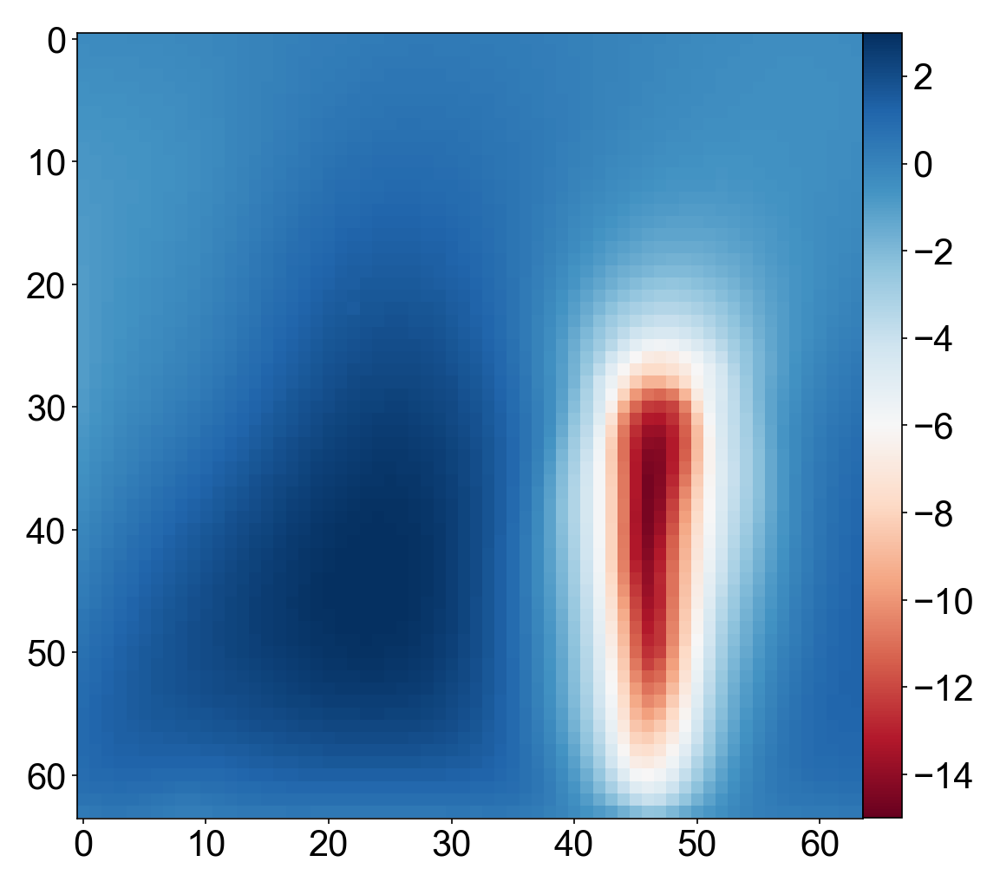

In [712]:
block_size = 16
reshaped_data = data_y.reshape(1024 // block_size, block_size, 1024 // block_size, block_size)
block_means = reshaped_data.mean(axis=(1, 3))
plt.figure()
plt.imshow(block_means, cmap="RdBu",vmin=-15,vmax=3)
cbar = plt.colorbar(pad=0)

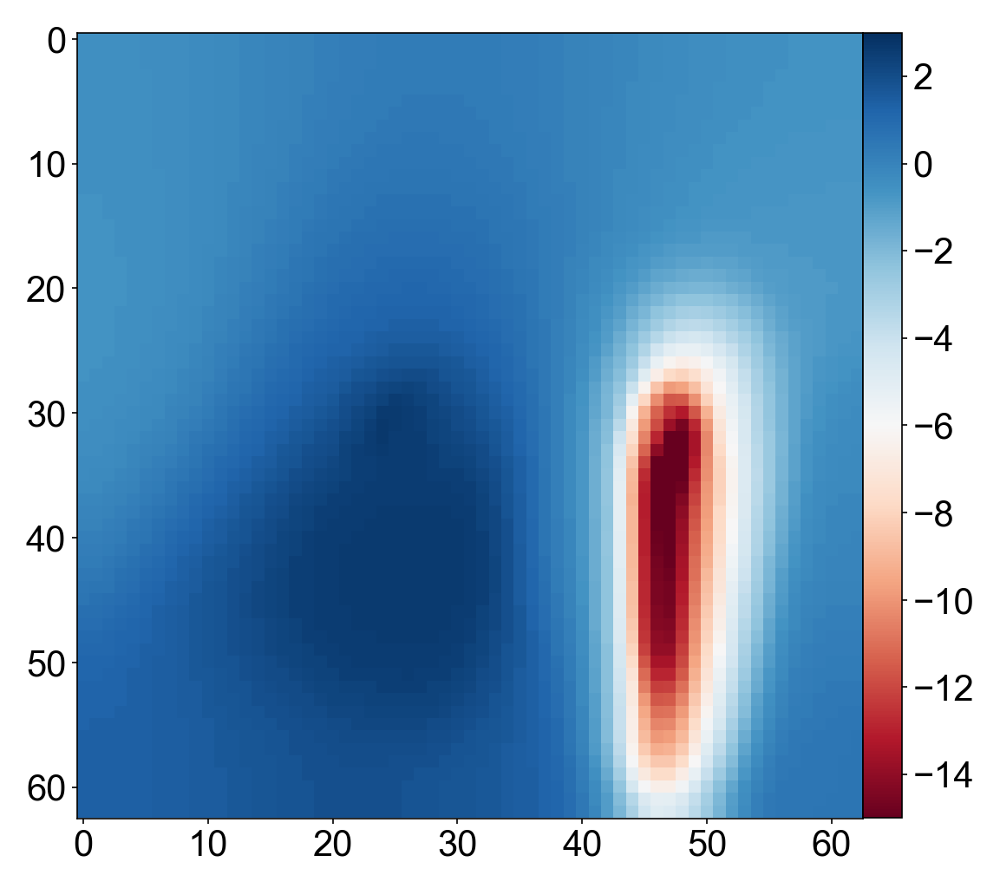

In [726]:
plt.imshow(Vy_0, cmap="RdBu",vmin=-15,vmax=3)
cbar = plt.colorbar(pad=0)

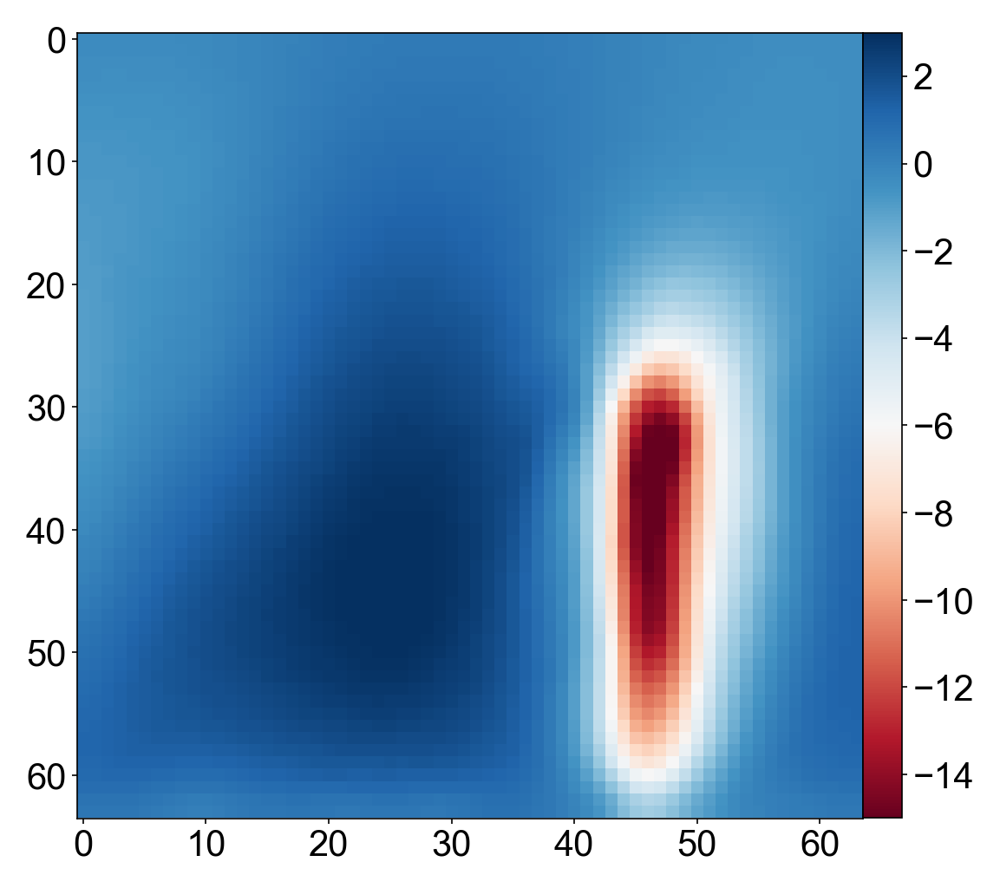

In [1074]:
ccpiv_noshadow = np.load("synthetic_2d_ccpiv_noshadow.npz")
plt.imshow(ccpiv_noshadow["v"], cmap="RdBu",vmin=-15,vmax=3)
cbar = plt.colorbar(pad=0)

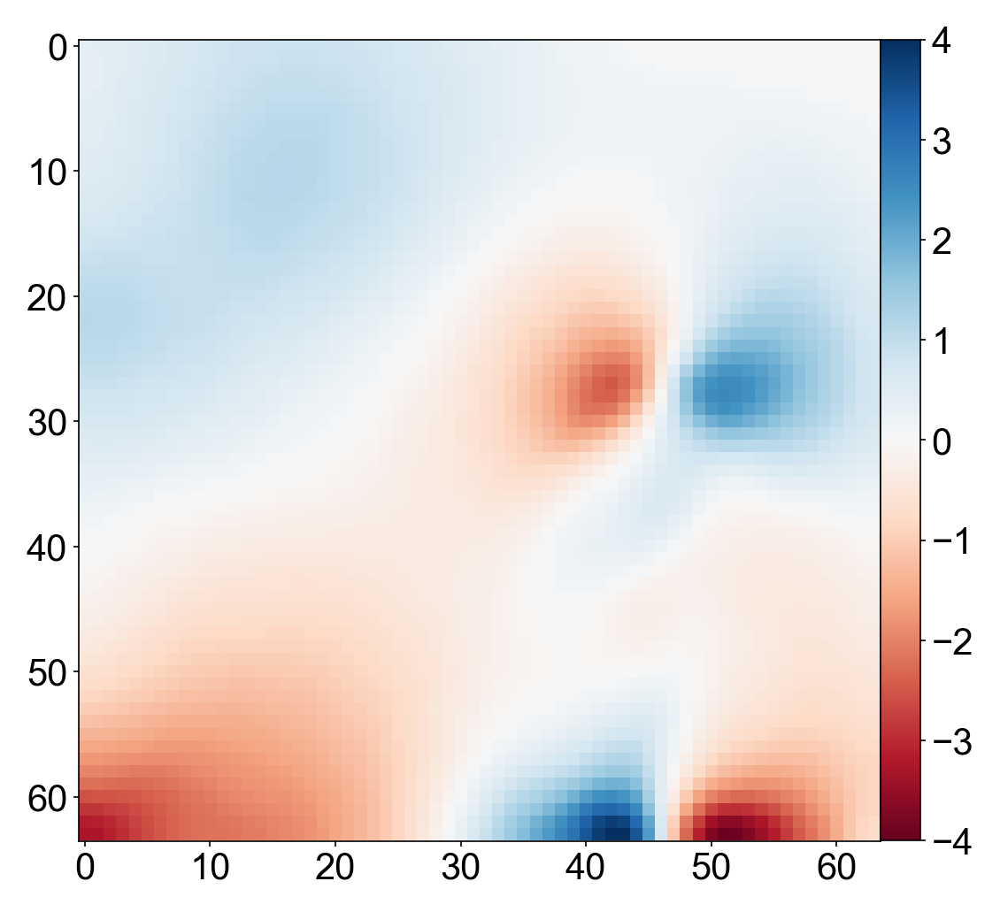

In [1075]:
plt.imshow(ccpiv_noshadow["u"], cmap="RdBu",vmin=-4,vmax=4)
cbar = plt.colorbar(pad=0)

In [1083]:
from skimage.measure import compare_ssim
from numpy import linalg as LA
def metrics(uout,vout):
    uin=ccpiv_noshadow["u"]
    vin=ccpiv_noshadow["v"]
#     anglenorm=np.sqrt(uout*uout+vout*vout)*np.sqrt(uin*uin+vin*vin)
#     cossum=(uin*uout+vin*vout)/anglenorm
#     anglediff=np.arccos(cossum)*180/pi


#     AAE=np.mean(anglediff)

    ydim,xdim = uin.shape
    diffu=uout-uin
    diffv=vout-vin
    N=ydim*xdim
    RMSE=np.sqrt((np.std(diffu)**2+np.std(diffv)**2))/N
    AEE=np.sqrt(LA.norm(diffu)**2+LA.norm(diffv)**2)/N
    
    SSIM1,smap1 = compare_ssim(uin,uout,data_range=np.max(uin)-np.min(uin),full=True)
    SSIM2,smap2 = compare_ssim(vin,vout,data_range=np.max(vin)-np.min(vin),full=True)
    smap_threshold = 0.5
#     print SSIM1,SSIM2,np.sum(smap1<smap_threshold)/64.**2,np.sum(smap2<smap_threshold)/64.**2
    SSIM = (SSIM1+SSIM2)/2
    SSIM_area = (np.sum(smap1<smap_threshold)+np.sum(smap2<smap_threshold))/2./N
    return RMSE,AEE,SSIM,SSIM_area

In [1084]:
metrics(Vx0,Vy0),metrics(Vx_0,Vy_0)

((0.00014061475823000567,
  0.009001677808394531,
  0.8970957183028445,
  0.0582275390625),
 (0.0001245833312700497,
  0.00798721986369432,
  0.8985298047099946,
  0.0382080078125))

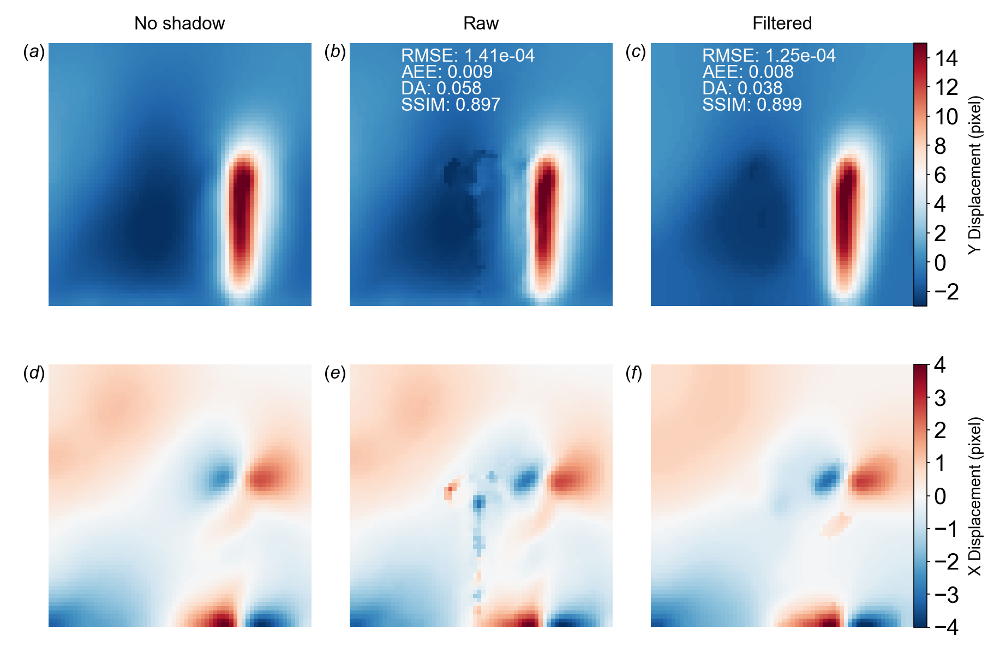

In [1281]:
fig, axes = plt.subplots(nrows=2, ncols=3,figsize=(6.68,4.2))
vlist=[ccpiv_noshadow["v"],Vy0,Vy_0]
ulist=[ccpiv_noshadow["u"],Vx0,Vx_0]
titles=["No shadow","Raw","Filtered"]
tcolor="white"
fs=8
loffset=-0.1
labellist = ["a","b","c","d","e","f"]
for i in range(3):
    ax=axes.flat[i]
    vi=vlist[i]
    title=titles[i]
    
    im = ax.imshow(-vi,cmap="RdBu_r",vmin=-3, vmax=15)
    ax.set_title(title,fontsize=fs)
    ax.axis('off')
    ax.annotate('$('+labellist[i]+')$', xy=(loffset, 1), xycoords='axes fraction', fontsize=fs, va='top')
    if i>0:
        uout=ulist[i]
        vout=vi
        RMSE,AEE,SSIM,SSIM_area = metrics(uout,vout)
        
        ax.text(12,4,"RMSE: "+"{:.2e}".format(RMSE),color=tcolor,fontsize=fs)
        ax.text(12,8,"AEE: "+"{:.3f}".format(AEE),color=tcolor,fontsize=fs)
        ax.text(12,12,"DA: "+"{:.3f}".format(SSIM_area),color=tcolor,fontsize=fs)
        ax.text(12,16,"SSIM: "+"{:.3f}".format(SSIM),color=tcolor,fontsize=fs)
        

imy = im

for i in range(3):
    ax=axes.flat[i+3]
    ui=ulist[i]
    title=titles[i]
    
    im = ax.imshow(ui,cmap="RdBu_r",vmin=-4, vmax=4)
    ax.annotate('$('+labellist[i+3]+')$', xy=(loffset, 1), xycoords='axes fraction', fontsize=fs, va='top')
#     ax.set_title(title,fontsize=fs)
    ax.axis('off')
imx = im
# plt.suptitle("synthetic_tests",fontsize=fs+2)

plt.tight_layout()
cb=fig.colorbar(imy, ax=axes.flatten()[:3],pad=0)
cb.set_label("Y Displacement (pixel)",fontsize=fs-1)
cb=fig.colorbar(imx, ax=axes.flatten()[3:],pad=0)
cb.set_label("X Displacement (pixel)",fontsize=fs-1)
plt.savefig("synthetic_metrics.svg")




In [1102]:
axes.flatten()

array([<matplotlib.axes._subplots.AxesSubplot object at 0x7f43b44bc790>,
      dtype=object)

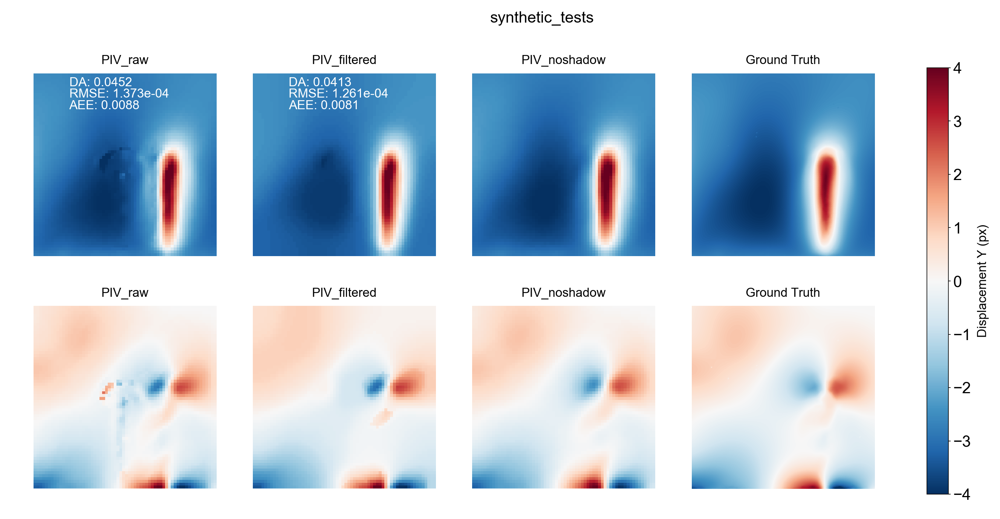

In [998]:
fig, axes = plt.subplots(nrows=2, ncols=4,figsize=(12,5))
vlist=[Vy0,Vy_0,ccpiv_noshadow["v"],-synthetic_per_pixel["v"][::-1,]]
ulist=[Vx0,Vx_0,ccpiv_noshadow["u"],synthetic_per_pixel["u"][::-1,]]
titles=["PIV_raw","PIV_filtered", "PIV_noshadow", "Ground Truth"]
tcolor="white"
fs=8
for i in range(4):
    ax=axes.flat[i]
    vi=vlist[i]
    title=titles[i]
    
    im = ax.imshow(-vi,cmap="RdBu_r",vmin=-3, vmax=15)
    ax.set_title(title,fontsize=fs)
    ax.axis('off')
    
    if i<2:
        uout=ulist[i]
        vout=vi
        RMSE,AEE,SSIM_area = metrics(uout,vout)
        ax.text(12,4,"DA: "+"{:.4f}".format(SSIM_area),color=tcolor,fontsize=fs)
        ax.text(12,8,"RMSE: "+"{:.3e}".format(RMSE),color=tcolor,fontsize=fs)
        ax.text(12,12,"AEE: "+"{:.4f}".format(AEE),color=tcolor,fontsize=fs)
for i in range(4):
    ax=axes.flat[i+4]
    ui=ulist[i]
    title=titles[i]
    
    im = ax.imshow(ui,cmap="RdBu_r",vmin=-4, vmax=4)
    ax.set_title(title,fontsize=fs)
    ax.axis('off')
        
cb=fig.colorbar(im, ax=axes.ravel().tolist())
cb.set_label("Displacement Y (px)",fontsize=fs)
plt.suptitle("synthetic_tests",fontsize=fs+2)
plt.show()

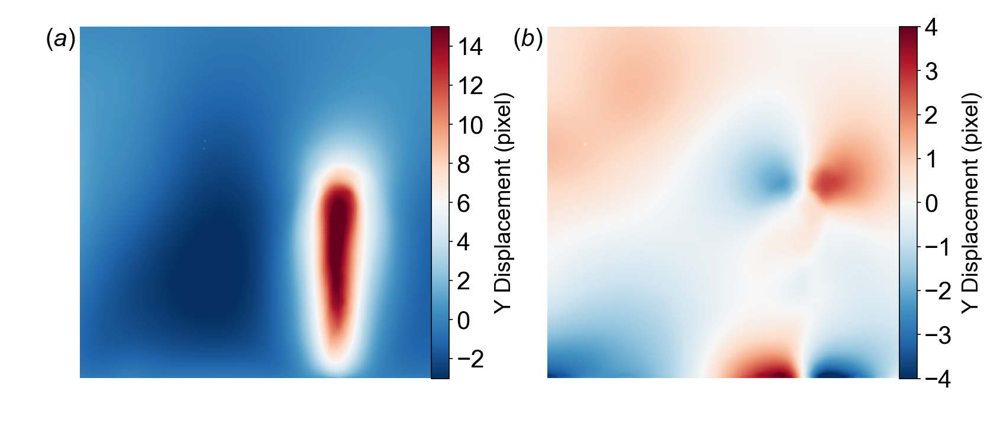

In [1276]:
loffset = -0.1
fs = 10
plt.figure(figsize=(6.68,2.5))
plt.subplot(1,2,1)
#scaled because WIDIM correction used a scaling to speed up convergence
#and only 2 WIDIM iterations are used
plt.imshow(synthetic_per_pixel["v"][::-1,]*1.1,cmap="RdBu_r",vmin=-3, vmax=15)
plt.axis('off')
plt.annotate('$(a)$', xy=(loffset, 1), xycoords='axes fraction', fontsize=fs, va='top')

cb=plt.colorbar(pad=0)
cb.set_label("Y Displacement (pixel)",fontsize=fs-1)


plt.subplot(1,2,2)
plt.imshow(synthetic_per_pixel["u"][::-1,]*1.1,cmap="RdBu_r",vmin=-4, vmax=4)
plt.axis('off')
plt.annotate('$(b)$', xy=(loffset, 1), xycoords='axes fraction', fontsize=fs, va='top')

cb=plt.colorbar(pad=0)
cb.set_label("Y Displacement (pixel)",fontsize=fs-1)

plt.tight_layout(w_pad = -8)
plt.savefig("gd_synthetic.svg")

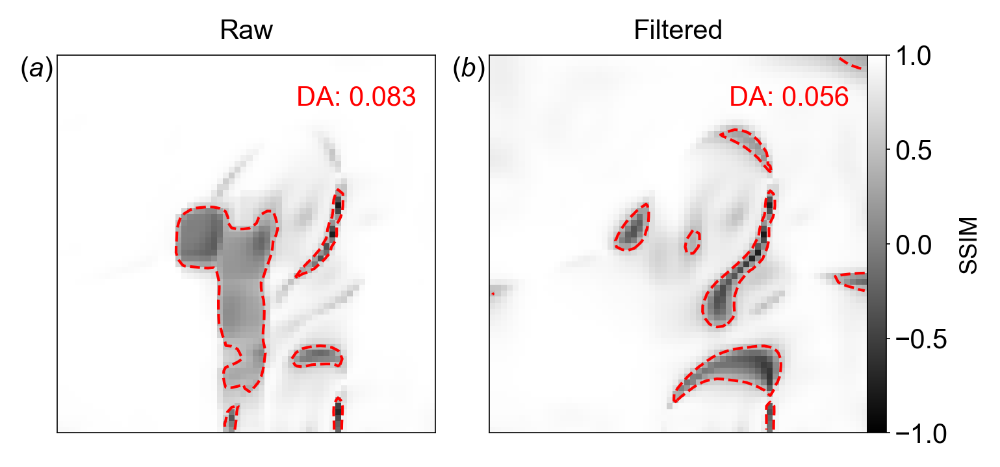

In [1311]:
from skimage.measure import find_contours
smap_threshold = 0.5
uin = ccpiv_noshadow["u"]

s1,smap1 = compare_ssim(uin,Vx_0,data_range=np.max(uin)-np.min(uin),full=True)
s0,smap0 = compare_ssim(uin,Vx0,data_range=np.max(uin)-np.min(uin),full=True)

# vin = ccpiv_noshadow["v"]

# s0v,smap0v = compare_ssim(vin,Vy0,data_range=np.max(vin)-np.min(vin),full=True)
# s1v,smap1v = compare_ssim(vin,Vy_0,data_range=np.max(vin)-np.min(vin),full=True)

# smap0 = (smap0 + smap0v)/2
# smap1 = (smap1 + smap1v)/2


loffset = -0.1
fs = 10

plt.figure(figsize=(6,2.5))
plt.subplot(1,2,1)
plt.imshow(smap0,cmap="gray",vmin=-1, vmax=1)
# plt.axis('off')
plt.xticks([], [])
plt.yticks([], [])
plt.annotate('$(a)$', xy=(loffset, 1), xycoords='axes fraction', fontsize=fs, va='top')
plt.title("Raw",fontsize=fs)
# Find contours
contours = find_contours(smap0, level=0.5)

# Plot each contour
for contour in contours:
    plt.plot(contour[:, 1], contour[:, 0], linestyle='--', linewidth=1, color='r')

SSIM_area = (np.sum(smap0<smap_threshold))/(np.product(smap0.shape)+0.0)
plt.text(40,8,"DA: "+"{:.3f}".format(SSIM_area),color="r",fontsize=fs)

# cb=plt.colorbar(pad=0, ticks=[-1, -0.5,0,0.5,1])
# cb.set_label("SSIM map",fontsize=fs-1)


plt.subplot(1,2,2)
plt.imshow(smap1,cmap="gray",vmin=-1, vmax=1)
# plt.axis('off')
plt.xticks([], [])
plt.yticks([], [])
plt.annotate('$(b)$', xy=(loffset, 1), xycoords='axes fraction', fontsize=fs, va='top')
plt.title("Filtered",fontsize=fs)
# Find contours
contours = find_contours(smap1, level=0.5)

# Plot each contour
for contour in contours:
    plt.plot(contour[:, 1], contour[:, 0], linestyle='--', linewidth=1, color='r')

SSIM_area = (np.sum(smap1<smap_threshold))/(np.product(smap1.shape)+0.0)
plt.text(40,8,"DA: "+"{:.3f}".format(SSIM_area),color="r",fontsize=fs)
    
    
cb=plt.colorbar(pad=0, ticks=[-1, -0.5,0,0.5,1])
cb.set_label("SSIM",fontsize=fs-1)

plt.tight_layout(w_pad = -10)
plt.savefig("smap.svg")



# Visiualize the synthetic particle images

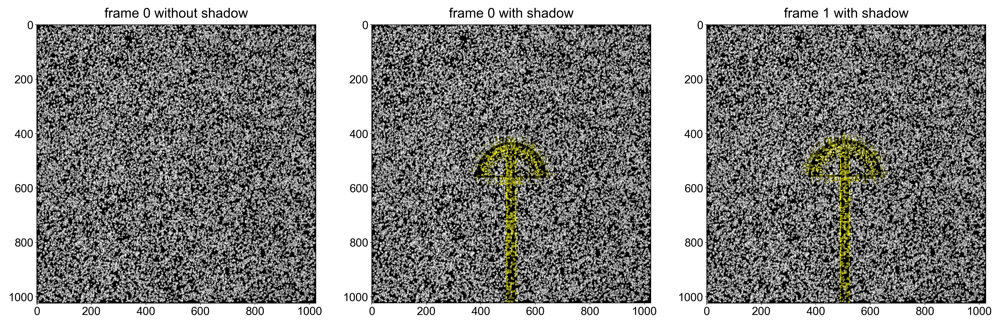

In [1320]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Load the images in grayscale
image_A = cv2.imread('/home/xbao/LAB_test/shadow_piv_sim/photon/sample-data/piv/22.5cm/images/tif/particle_image_frame_0001_clean.tif', cv2.IMREAD_GRAYSCALE)
image_B = cv2.imread('/home/xbao/LAB_test/shadow_piv_sim/photon/sample-data/piv/22.5cm/images/tif/particle_image_frame_0001.tif', cv2.IMREAD_GRAYSCALE)

# Ensure the images have the same dimensions
if image_A.shape != image_B.shape:
    raise ValueError("Images must have the same dimensions")

# Find the absolute difference between the two images
difference = cv2.absdiff(image_A, image_B)

# Create a mask where the differences are non-zero
mask = difference > 10

# Convert image B to a color image (3 channels)
image_B_color = cv2.cvtColor(image_B, cv2.COLOR_GRAY2BGR)

# Create a highlighted image by copying the color version of image B
highlighted_image = image_B_color.copy()

# Highlight differences in yellow color while preserving the intensity
# Yellow color in BGR is (0, 255, 255), so we need to scale this color by the intensity of image B
highlighted_image[mask] = np.stack([image_B[mask] * 0, image_B[mask], image_B[mask]], axis=-1)

image_A0 = image_A.copy()
image_A1 = highlighted_image.copy()



# Load the images in grayscale
image_A = cv2.imread('/home/xbao/LAB_test/shadow_piv_sim/photon/sample-data/piv/22.5cm/images/tif/particle_image_frame_0002_clean.tif', cv2.IMREAD_GRAYSCALE)
image_B = cv2.imread('/home/xbao/LAB_test/shadow_piv_sim/photon/sample-data/piv/22.5cm/images/tif/particle_image_frame_0002.tif', cv2.IMREAD_GRAYSCALE)

# Ensure the images have the same dimensions
if image_A.shape != image_B.shape:
    raise ValueError("Images must have the same dimensions")

# Find the absolute difference between the two images
difference = cv2.absdiff(image_A, image_B)

# Create a mask where the differences are non-zero
mask = difference > 10

# Convert image B to a color image (3 channels)
image_B_color = cv2.cvtColor(image_B, cv2.COLOR_GRAY2BGR)

# Create a highlighted image by copying the color version of image B
highlighted_image = image_B_color.copy()

# Highlight differences in yellow color while preserving the intensity
# Yellow color in BGR is (0, 255, 255), so we need to scale this color by the intensity of image B
highlighted_image[mask] = np.stack([image_B[mask] * 0, image_B[mask], image_B[mask]], axis=-1)

image_B0 = image_A.copy()
image_B1 = highlighted_image.copy()


# Display the images
plt.figure(figsize=(15, 5))

plt.subplot(1, 3, 1)
plt.title('frame 0 without shadow')
plt.imshow(image_A0, cmap='gray')

plt.subplot(1, 3, 2)
plt.title('frame 0 with shadow')
plt.imshow(cv2.cvtColor(image_A1, cv2.COLOR_BGR2RGB))

plt.subplot(1, 3, 3)
plt.title('frame 1 with shadow')
plt.imshow(cv2.cvtColor(image_B1, cv2.COLOR_BGR2RGB))

# setup and plot of the density gradient zone

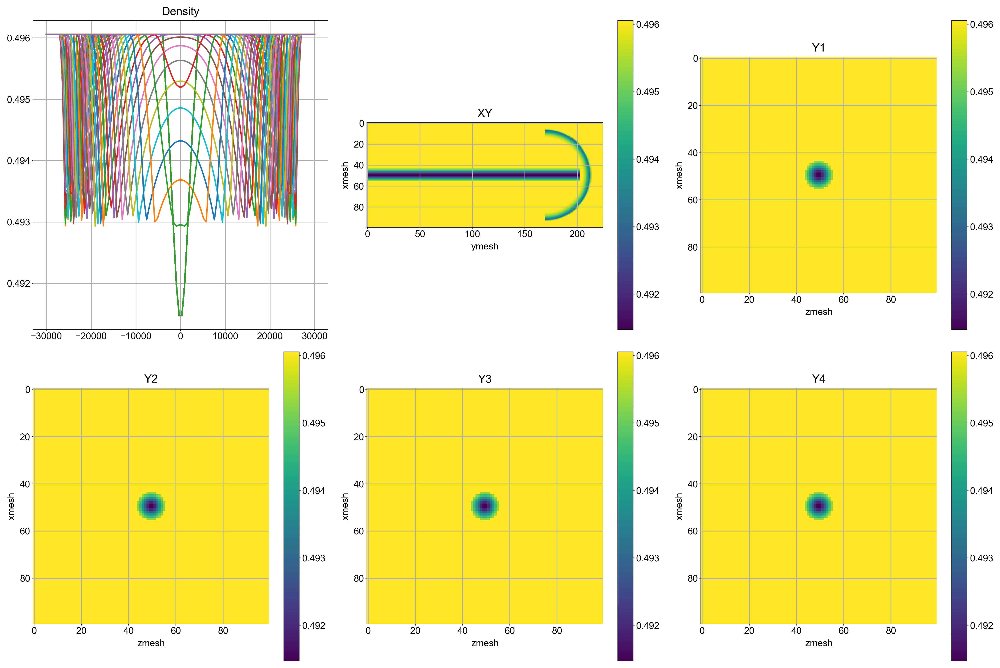

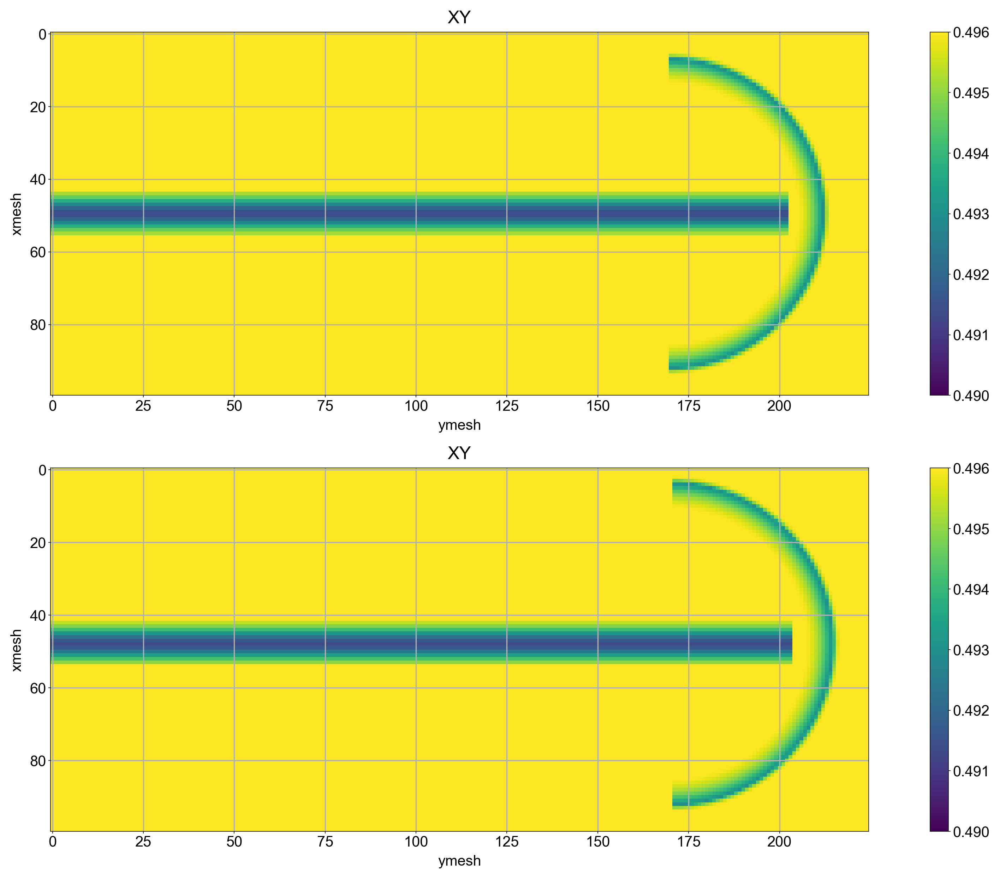

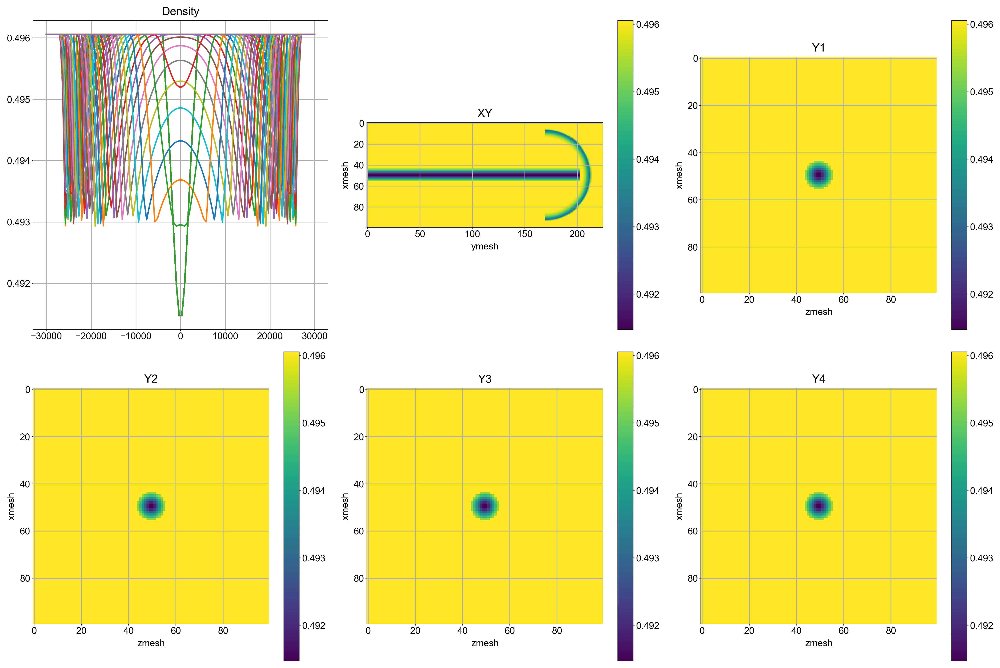

In [1322]:


import numpy as np
import matplotlib.pyplot as plt
from sys import argv

#script, first, second, third = argv

data = {}
nx = 100
ny = 225
nz = 100
z_object = 0#750e3-5e4
#<<<<<<< Updated upstream

#Z_Min = -3.0e2
#Z_Max = 3.0e02

Z_Max = z_object - 10e4
Z_Min = z_object - 16e4
# X_Velocity = 01.0e3
# Y_Velocity = 01.0e3
#Z_Velocity = 00.1e3

data['x'] = np.linspace(-30e3,30e3,nx).astype('float32')# - X_Velocity/2
data['y'] = np.linspace(-11.25e4,2.25e4,ny).astype('float32')# - Y_Velocity/2
# data['z'] = np.linspace(-15e3,15e3,nz).astype('float32') + z_object - Z_Velocity/2
#data['z'] = np.linspace(8.7e5,9.5e5,nz).astype('float32')
#data['z'] = np.linspace(Z_Min,Z_Max,nz).astype('float32') + z_object
data['z'] = np.linspace(Z_Min, Z_Max, nz).astype('float32')

#print "del_x", data['x'][1] - data['x'][0]

'''
# convert co-ordinates from microns to meters
data['x']/=1.0e6
data['y']/=1.0e6
data['z']/=1.0e6
'''
# specify gradients for x and y directions
#grad_x = np.float64(first)

#grad_xx = 50.0 
grad_x = 5
grad_y = 0.0

x = np.array(data['x'])
y = np.array(data['y'])
z = np.array(data['z'])

X,Y = np.meshgrid(x,y,indexing='ij')

def n_syrup(T):
    return -2.058*1e-4*T +1.5012 -1

data['rho'] = n_syrup(25)*np.ones([nx,ny,nz])
g_mean = 0.5
g_amp = (n_syrup(25)+1)*0.0035#1.225*5e-1
X_eff = (X - x.min())/(X.max() - x.min())
g_std = 0.03

gz_mean = (Z_Max + Z_Min)/2
stem_radius = 0.15/2.5
gradient_width = 0.03

inner_radius = 0.35
outer_radius = 0.45
Y_interface = (y.min() + y.max())/2 + 2.95e4 + 0.5e4
def head_damp(radius,inner_radius,outer_radius):
    ridge_line = 0.8
    ridge_radius = (outer_radius - inner_radius) * ridge_line + inner_radius
    mask_upper = np.array(radius>=ridge_radius,dtype=int)
    mask_lower = np.array(radius<ridge_radius,dtype=int)
    damp_ = (radius - ridge_radius)/(outer_radius - ridge_radius)*mask_upper + (ridge_radius - radius)/(ridge_radius - inner_radius)*mask_lower
    return (1 - damp_)**2

def stem_damp(radius,stem_radius):
    platform_line = 0.9
    return (1-radius/stem_radius) * np.array(radius>=stem_radius*platform_line,dtype=int) + np.array(radius<stem_radius*platform_line,dtype=int)
for k in range(0,nz):
    rad_2 = (X_eff-g_mean)**2 + ((z[k]-gz_mean)/(X.max() - x.min()))**2
    stem_bool = (rad_2<=stem_radius**2)&(Y<=Y_interface+2e4)
    valley_mask = np.array(stem_bool,dtype=int)
    data['rho'][:,:,k] -= valley_mask*g_amp*0.9*np.exp(-rad_2/(2*g_std**2))#stem_damp(np.sqrt(rad_2),stem_radius)#np.exp(-rad_2/(2*g_std**2))

    rad_3d_2 = (X_eff-g_mean)**2 + ((z[k]-gz_mean)/(X.max() - x.min()))**2 + ((Y-Y_interface)/(X.max() - x.min()))**2
    shell_mask = np.array((rad_3d_2<=outer_radius**2)&(rad_3d_2>=inner_radius**2)&(np.invert(stem_bool))&(Y>Y_interface),dtype=int)
    data['rho'][:,:,k] -= shell_mask*g_amp*0.6*head_damp(np.sqrt(rad_3d_2),inner_radius,outer_radius)


    # gradient_mask = np.array(np.array(rad_2<radius**2)&np.array(rad_2>(radius-gradient_width)**2),dtype=int)
    # data['rho'][:,:,k] -= gradient_mask*g_amp/4
    # data['rho'][:,:,k] -= g_amp*np.exp(-(X_eff-g_mean)**2/(2*g_std**2))
# pattern = np.ones_like(X)*grad_x
# pattern[:len(x)//2]=0
# pattern[int(len(x)//2+len(x)//10):]=0
# for k in range(0,nz):
#     data['rho'][:,:,k] -= pattern * (X - x.min())/(X.max() - x.min()) #+ grad_xx * (X - x.min())**2/(X.max() - x.min())**2 # + grad_y*(Y - y.min())/Y.max()

#print "multiplying factor:", (X-x.min())/(X.max() - x.min())
#print "del_rho:", (data['rho'][1,0,0] - data['rho'][0,0,0])
nrrd_filename = '/home/xbao/LAB_test/shadow_piv_sim/photon/sample-data/piv/plume_1.nrrd'

# save_nrrd(data,nrrd_filename)


# Create a figure with a grid of subplots
fig, axes = plt.subplots(2, 3, figsize=(15, 10))

# Plot the first graph
axes[0, 0].plot(data['x'], data['rho'][:, :, nz//2])
axes[0, 0].set_title("Density")
axes[0, 0].grid()

# Plot the second graph
im = axes[0, 1].imshow(data['rho'][:, :, nz//2])
axes[0, 1].set_xlabel("ymesh")
axes[0, 1].set_ylabel("xmesh")
fig.colorbar(im, ax=axes[0, 1])
axes[0, 1].set_title("XY")
axes[0, 1].grid()

# Plot the remaining four graphs
for i in range(4):
    im = axes[(i+2)//3, (i+2)%3].imshow(data['rho'][:, ny//4 * i, :])
    axes[(i+2)//3, (i+2)%3].set_xlabel("zmesh")
    axes[(i+2)//3, (i+2)%3].set_ylabel("xmesh")
    fig.colorbar(im, ax=axes[(i+2)//3, (i+2)%3])
    axes[(i+2)//3, (i+2)%3].set_title("Y"+str(i+1))
    axes[(i+2)//3, (i+2)%3].grid()

# Adjust layout
plt.tight_layout()
plt.show()

data_2 = data.copy()

data_2['rho'] = n_syrup(25)*np.ones([nx,ny,nz])
nrrd_filename = '/home/xbao/LAB_test/shadow_piv_sim/photon/sample-data/piv/plume_2.nrrd'
inner_radius = inner_radius*1.04
outer_radius = outer_radius*1.04
Y_interface = (y.min() + y.max())/2 + 3e4 + 0.5e4
for k in range(0,nz):
    rad_2 = (X_eff-g_mean+0.016)**2 + ((z[k]-gz_mean)/(X.max() - x.min()))**2
    stem_bool = (rad_2<=stem_radius**2)&(Y<=Y_interface+2e4)
    valley_mask = np.array(stem_bool,dtype=int)
    data_2['rho'][:,:,k] -= valley_mask*g_amp*0.9*np.exp(-rad_2/(2*g_std**2))#stem_damp(np.sqrt(rad_2),stem_radius)#np.exp(-rad_2/(2*g_std**2))

    rad_3d_2 = (X_eff-g_mean+0.016)**2 + ((z[k]-gz_mean)/(X.max() - x.min()))**2 + ((Y-Y_interface)/(X.max() - x.min()))**2
    shell_mask = np.array((rad_3d_2<=outer_radius**2)&(rad_3d_2>=inner_radius**2)&(np.invert(stem_bool))&(Y>Y_interface),dtype=int)
    data_2['rho'][:,:,k] -= shell_mask*g_amp*0.6*head_damp(np.sqrt(rad_3d_2),inner_radius,outer_radius)


# save_nrrd(data_2,nrrd_filename)



# Create a figure with a grid of subplots
fig, axes = plt.subplots(2, 1, figsize=(15, 10))

# Plot the second graph
plt.sca(axes[0])
im = plt.imshow(data['rho'][:, :, nz//2],vmin=0.49,vmax=0.496)
plt.xlabel("ymesh")
plt.ylabel("xmesh")
plt.colorbar(im)
plt.title("XY")
plt.grid()

plt.sca(axes[1])
im = plt.imshow(data_2['rho'][:, :, nz//2],vmin=0.49,vmax=0.496)
plt.xlabel("ymesh")
plt.ylabel("xmesh")
plt.colorbar(im)
plt.title("XY")
plt.grid()


# Create a figure with a grid of subplots
fig, axes = plt.subplots(2, 3, figsize=(15, 10))

# Plot the first graph
axes[0, 0].plot(data['x'], data['rho'][:, :, nz//2])
axes[0, 0].set_title("Density")
axes[0, 0].grid()

# Plot the second graph
im = axes[0, 1].imshow(data['rho'][:, :, nz//2])
axes[0, 1].set_xlabel("ymesh")
axes[0, 1].set_ylabel("xmesh")
fig.colorbar(im, ax=axes[0, 1])
axes[0, 1].set_title("XY")
axes[0, 1].grid()

# Plot the remaining four graphs
for i in range(4):
    im = axes[(i+2)//3, (i+2)%3].imshow(data['rho'][:, ny//4 * i, :])
    axes[(i+2)//3, (i+2)%3].set_xlabel("zmesh")
    axes[(i+2)//3, (i+2)%3].set_ylabel("xmesh")
    fig.colorbar(im, ax=axes[(i+2)//3, (i+2)%3])
    axes[(i+2)//3, (i+2)%3].set_title("Y"+str(i+1))
    axes[(i+2)//3, (i+2)%3].grid()

# Adjust layout
plt.tight_layout()
plt.show()





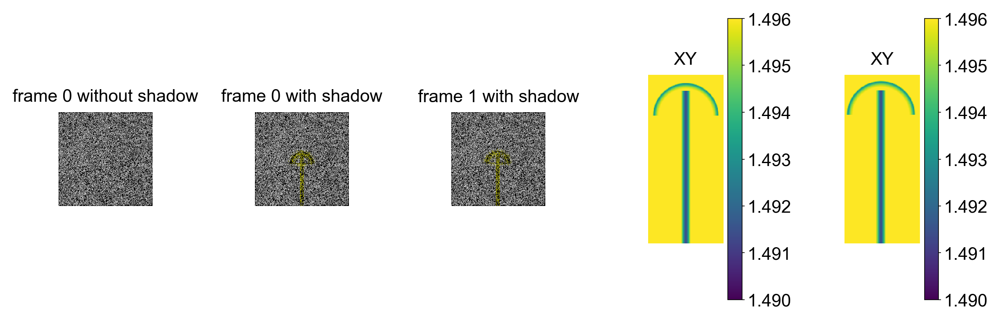

In [1139]:
fs=10
plt.figure(figsize=(8, 5))

plt.subplot(1, 5, 1)
plt.title('frame 0 without shadow',fontsize = fs)
plt.imshow(image_A0, cmap='gray')
plt.axis('off')


plt.subplot(1, 5, 2)
plt.title('frame 0 with shadow',fontsize = fs)
plt.imshow(cv2.cvtColor(image_A1, cv2.COLOR_BGR2RGB))
plt.axis('off')

plt.subplot(1, 5, 4)
im = plt.imshow(data['rho'][:, :, nz//2].T[::-1]+1,vmin=1.49,vmax=1.496)
plt.xlabel("ymesh")
plt.ylabel("xmesh")
plt.colorbar(im)
plt.title("XY",fontsize = fs)
plt.axis('off')
# plt.grid()


# plt.subplot(2, 3, 4)
# plt.title('frame 1 without shadow',fontsize = fs)
# plt.imshow(image_B0, cmap='gray')
# plt.axis('off')


plt.subplot(1, 5, 3)
plt.title('frame 1 with shadow',fontsize = fs)
plt.imshow(cv2.cvtColor(image_B1, cv2.COLOR_BGR2RGB))
plt.axis('off')



plt.subplot(1, 5, 5)
im = plt.imshow(data_2['rho'][:, :, nz//2].T[::-1]+1,vmin=1.49,vmax=1.496)
# plt.xlabel("ymesh")
# plt.ylabel("xmesh")
plt.colorbar(im)
plt.title("XY",fontsize = fs)
plt.axis('off')
# plt.grid()
plt.tight_layout()


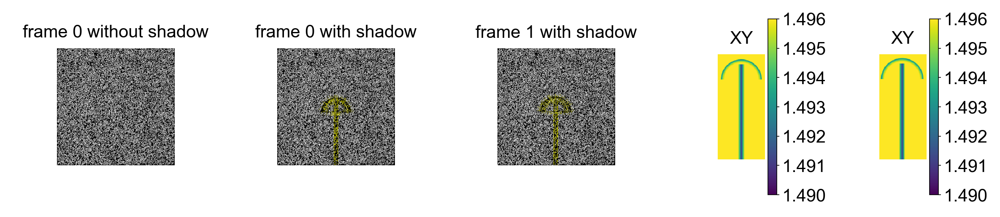

In [1143]:
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import cv2

fs = 10
fig = plt.figure(figsize=(8, 5))
gs = gridspec.GridSpec(1, 5, width_ratios=[1, 1, 1, 0.5, 0.5])

# Subplot 1
ax1 = fig.add_subplot(gs[0, 0])
ax1.set_title('frame 0 without shadow', fontsize=fs)
ax1.imshow(image_A0, cmap='gray')
ax1.axis('off')

# Subplot 2
ax2 = fig.add_subplot(gs[0, 1])
ax2.set_title('frame 0 with shadow', fontsize=fs)
ax2.imshow(cv2.cvtColor(image_A1, cv2.COLOR_BGR2RGB))
ax2.axis('off')

# Subplot 3
ax3 = fig.add_subplot(gs[0, 3])
im = ax3.imshow(data['rho'][:, :, nz//2].T[::-1] + 1, vmin=1.49, vmax=1.496)
ax3.set_xlabel("ymesh")
ax3.set_ylabel("xmesh")
ax3.set_title("XY", fontsize=fs)
ax3.axis('off')
fig.colorbar(im, ax=ax3, orientation='vertical')

# Subplot 4
ax4 = fig.add_subplot(gs[0, 2])
ax4.set_title('frame 1 with shadow', fontsize=fs)
ax4.imshow(cv2.cvtColor(image_B1, cv2.COLOR_BGR2RGB))
ax4.axis('off')

# Subplot 5
ax5 = fig.add_subplot(gs[0, 4])
im = ax5.imshow(data_2['rho'][:, :, nz//2].T[::-1] + 1, vmin=1.49, vmax=1.496)
ax5.set_title("XY", fontsize=fs)
ax5.axis('off')
fig.colorbar(im, ax=ax5, orientation='vertical')

# Adjust layout
plt.tight_layout()

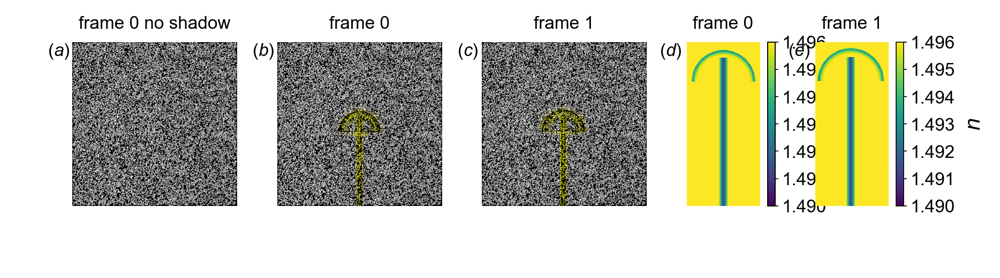

In [1186]:
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import cv2
from mpl_toolkits.axes_grid1 import make_axes_locatable

fs = 8
loffset = -0.15
fig = plt.figure(figsize=(6.68, 5))
gs = gridspec.GridSpec(1, 5, width_ratios=[1, 1, 1, 0.537, 0.537], wspace=0.3)  # Adjust wspace to control spacing

# Subplot 1
ax1 = fig.add_subplot(gs[0, 0])
ax1.set_title('frame 0 no shadow', fontsize=fs)
ax1.imshow(image_A0, cmap='gray')
ax1.axis('off')
plt.annotate('$(a)$', xy=(loffset, 1), xycoords='axes fraction', fontsize=fs, va='top')

# Subplot 2
ax2 = fig.add_subplot(gs[0, 1])
ax2.set_title('frame 0', fontsize=fs)
ax2.imshow(cv2.cvtColor(image_A1, cv2.COLOR_BGR2RGB))
ax2.axis('off')
plt.annotate('$(b)$', xy=(loffset, 1), xycoords='axes fraction', fontsize=fs, va='top')




# Subplot 3
ax3 = fig.add_subplot(gs[0, 2])
ax3.set_title('frame 1', fontsize=fs)
ax3.imshow(cv2.cvtColor(image_B1, cv2.COLOR_BGR2RGB))
ax3.axis('off')
plt.annotate('$(c)$', xy=(loffset, 1), xycoords='axes fraction', fontsize=fs, va='top')



# Subplot 4
ax4 = fig.add_subplot(gs[0, 3])
im4 = ax4.imshow(data['rho'][:, :, nz // 2].T[::-1] + 1, vmin=1.49, vmax=1.496)
ax4.set_xlabel("ymesh")
ax4.set_ylabel("xmesh")
ax4.set_title("frame 0", fontsize=fs)
ax4.axis('off')
plt.annotate('$(d)$', xy=(loffset*2.5, 1), xycoords='axes fraction', fontsize=fs, va='top')

# Adding colorbar that matches the height of the subplot
divider3 = make_axes_locatable(ax4)
cax4 = divider3.append_axes("right", size="10%", pad=0.05)
cbar = fig.colorbar(im3, cax=cax4)
cbar = fig.colorbar(im3, cax=cax4)
cbar.ax.tick_params(labelsize=fs) 



# Subplot 5
ax5 = fig.add_subplot(gs[0, 4])
im5 = ax5.imshow(data_2['rho'][:, :, nz // 2].T[::-1] + 1, vmin=1.49, vmax=1.496)
ax5.set_title("frame 1", fontsize=fs)
ax5.axis('off')
plt.annotate('$(e)$', xy=(loffset*2.5, 1), xycoords='axes fraction', fontsize=fs, va='top')


# Adding colorbar that matches the height of the subplot
divider5 = make_axes_locatable(ax5)
cax5 = divider5.append_axes("right", size="10%", pad=0.05)
cbar = fig.colorbar(im5, cax=cax5)
cbar.set_label("$n$")
cbar.ax.tick_params(labelsize=fs) 
# Adjust layout
plt.tight_layout()
# plt.savefig("particle_image_syn.svg")

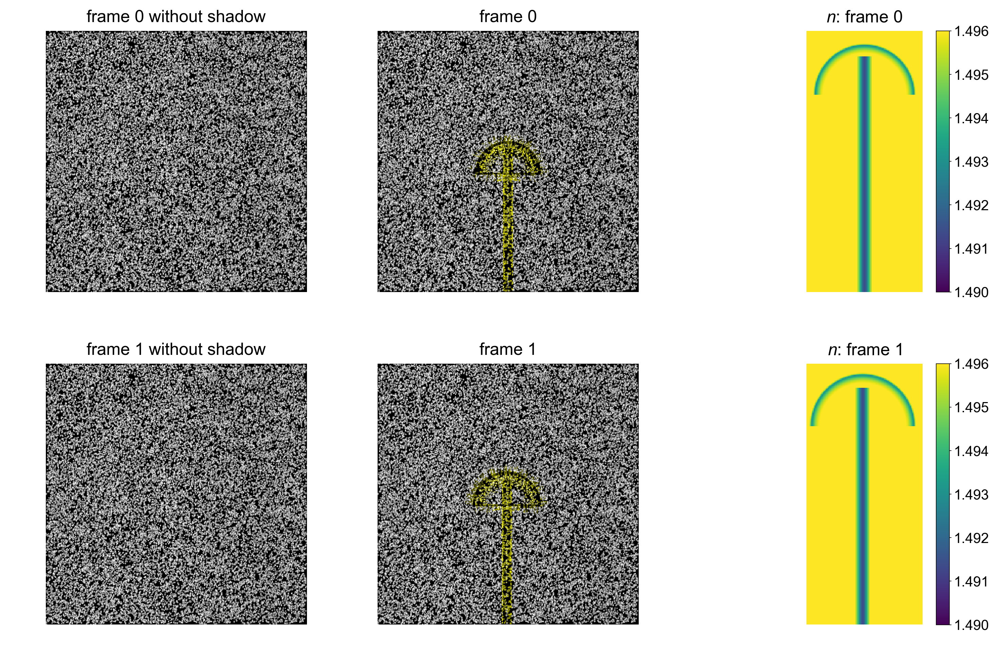

In [1201]:
fs=12
plt.figure(figsize=(10, 6.5))

plt.subplot(2, 3, 1)
plt.title('frame 0 without shadow',fontsize = fs)
plt.imshow(image_A0, cmap='gray')
plt.axis('off')


plt.subplot(2, 3, 2)
plt.title('frame 0',fontsize = fs)
plt.imshow(cv2.cvtColor(image_A1, cv2.COLOR_BGR2RGB))
plt.axis('off')

plt.subplot(2, 3, 3)
im = plt.imshow(data['rho'][:, :, nz//2].T[::-1]+1,vmin=1.49,vmax=1.496)
plt.xlabel("ymesh")
plt.ylabel("xmesh")
plt.colorbar(im)
plt.title("$n$: frame 0",fontsize = fs)
plt.axis('off')
# plt.grid()


plt.subplot(2, 3, 4)
plt.title('frame 1 without shadow',fontsize = fs)
plt.imshow(image_B0, cmap='gray')
plt.axis('off')


plt.subplot(2, 3, 5)
plt.title('frame 1',fontsize = fs)
plt.imshow(cv2.cvtColor(image_B1, cv2.COLOR_BGR2RGB))
plt.axis('off')



plt.subplot(2, 3, 6)
im = plt.imshow(data_2['rho'][:, :, nz//2].T[::-1]+1,vmin=1.49,vmax=1.496)
# plt.xlabel("ymesh")
# plt.ylabel("xmesh")
plt.colorbar(im)
plt.title("$n$: frame 1",fontsize = fs)
plt.axis('off')
# plt.grid()
plt.tight_layout()
plt.savefig("particle_image_synthetic.svg")


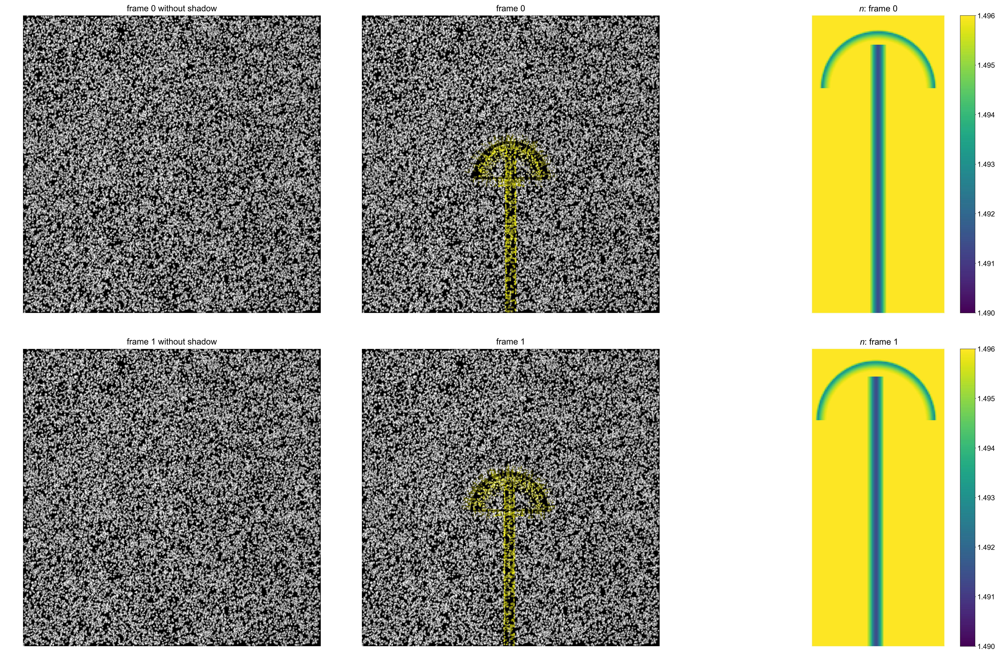

In [1323]:
fs=12
plt.figure(figsize=(20, 13))

plt.subplot(2, 3, 1)
plt.title('frame 0 without shadow',fontsize = fs)
plt.imshow(image_A0, cmap='gray')
plt.axis('off')


plt.subplot(2, 3, 2)
plt.title('frame 0',fontsize = fs)
plt.imshow(cv2.cvtColor(image_A1, cv2.COLOR_BGR2RGB))
plt.axis('off')

plt.subplot(2, 3, 3)
im = plt.imshow(data['rho'][:, :, nz//2].T[::-1]+1,vmin=1.49,vmax=1.496)
plt.xlabel("ymesh")
plt.ylabel("xmesh")
plt.colorbar(im)
plt.title("$n$: frame 0",fontsize = fs)
plt.axis('off')
# plt.grid()


plt.subplot(2, 3, 4)
plt.title('frame 1 without shadow',fontsize = fs)
plt.imshow(image_B0, cmap='gray')
plt.axis('off')


plt.subplot(2, 3, 5)
plt.title('frame 1',fontsize = fs)
plt.imshow(cv2.cvtColor(image_B1, cv2.COLOR_BGR2RGB))
plt.axis('off')



plt.subplot(2, 3, 6)
im = plt.imshow(data_2['rho'][:, :, nz//2].T[::-1]+1,vmin=1.49,vmax=1.496)
# plt.xlabel("ymesh")
# plt.ylabel("xmesh")
plt.colorbar(im)
plt.title("$n$: frame 1",fontsize = fs)
plt.axis('off')
# plt.grid()
plt.tight_layout()
plt.savefig("particle_image_synthetic_large.svg")


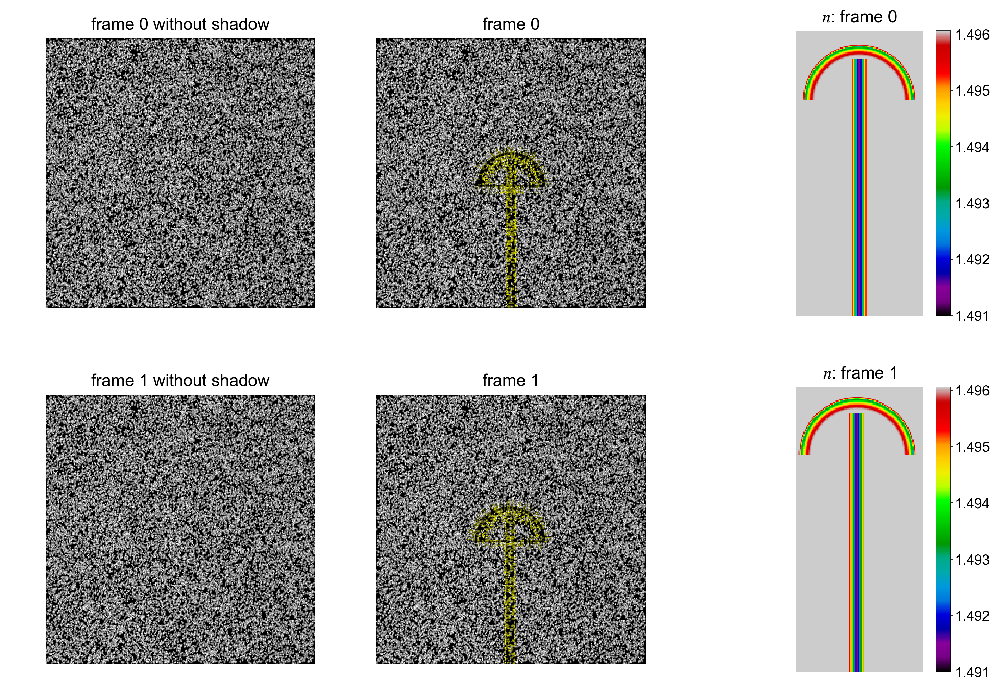

In [1377]:
fs=12
plt.figure(figsize=(10, 7))

plt.subplot(2, 3, 1)
plt.title('frame 0 without shadow',fontsize = fs)
plt.imshow(image_A0, cmap='gray')
plt.axis('off')


plt.subplot(2, 3, 2)
plt.title('frame 0',fontsize = fs)
plt.imshow(cv2.cvtColor(image_A1, cv2.COLOR_BGR2RGB))
plt.axis('off')

plt.subplot(2, 3, 3)
im = plt.imshow(data['rho'][:, :, nz//2].T[::-1]+1,cmap="nipy_spectral",vmin=1.491,vmax=1.49606)
plt.xlabel("ymesh")
plt.ylabel("xmesh")
plt.colorbar(im)
plt.title("$n$: frame 0",fontsize = fs)
plt.axis('off')
# plt.grid()


plt.subplot(2, 3, 4)
plt.title('frame 1 without shadow',fontsize = fs)
plt.imshow(image_B0, cmap='gray')
plt.axis('off')


plt.subplot(2, 3, 5)
plt.title('frame 1',fontsize = fs)
plt.imshow(cv2.cvtColor(image_B1, cv2.COLOR_BGR2RGB))
plt.axis('off')



plt.subplot(2, 3, 6)
im = plt.imshow(data_2['rho'][:, :, nz//2].T[::-1]+1,cmap="nipy_spectral",vmin=1.491,vmax=1.49606)
# plt.xlabel("ymesh")
# plt.ylabel("xmesh")
plt.colorbar(im)
plt.title("$n$: frame 1",fontsize = fs)
plt.axis('off')
# plt.grid()
plt.tight_layout()
plt.savefig("particle_image_synthetic_large.svg")
